# Starting

Run the following code to import the modules you'll need. After you finish the assignment, remember to run all cells and convert the notebook to a .pdf file for Gradescope submission.

In [1]:
!pip install torchsummary
import pickle
import numpy as np
import matplotlib.pyplot as plt
import os
import time
import itertools
from matplotlib import image
import glob as glob
from PIL import Image

import torch
import torchvision
from torchvision import datasets, models, transforms
import torch.nn as nn
import torch.optim as optim
from torch.autograd import Variable
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
from torchsummary import summary

print("PyTorch Version: ",torch.__version__)
print("Torchvision Version: ",torchvision.__version__)
# Detect if we have a GPU available
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
if torch.cuda.is_available():
  print("Using the GPU!")
else:
  print("WARNING: Could not find GPU! Using CPU only. If you want to enable GPU, please to go Edit > Notebook Settings > Hardware Accelerator and select GPU.")


PyTorch Version:  1.10.0+cu113
Torchvision Version:  0.11.1+cu113
Using the GPU!


# Problem 6.1 pix2pix
You will build pix2pix for image translation. 

In this question, you will need to:

1. Contruct dataloaders for train/test datasets
2. Build Generator and Discriminator
3. Train pix2pix and visualize the results during training
4. Plot the loss of generator/discriminator v.s. iteration
5. Design your own shoes (optional)

## Step 0: Downloading the dataset.

We first download the `mini-edges2shoes` dataset sampled from the original `edges2shoes` dataset. The `mini-edges2shoes` dataset contains 1,000 training image pairs, and 100 testing image pairs.

There's nothing you need to implement for this part.

In [2]:
# Download the mini-edges2shoes dataset
!rm -r mini-edges2shoes.zip
!rm -r mini-edges2shoes
!wget http://www.eecs.umich.edu/courses/eecs442-ahowens/mini-edges2shoes.zip
!unzip -q mini-edges2shoes.zip

rm: cannot remove 'mini-edges2shoes': No such file or directory
URL transformed to HTTPS due to an HSTS policy
--2022-10-16 13:09:39--  https://www.eecs.umich.edu/courses/eecs442-ahowens/mini-edges2shoes.zip
Resolving www.eecs.umich.edu (www.eecs.umich.edu)... 141.212.113.199
Connecting to www.eecs.umich.edu (www.eecs.umich.edu)|141.212.113.199|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 48660290 (46M) [application/zip]
Saving to: ‘mini-edges2shoes.zip’

mini-edges2shoes.zi 100%[===================>]  46.41M  5.34MB/s    in 9.0s    

2022-10-16 13:09:48 (5.14 MB/s) - ‘mini-edges2shoes.zip’ saved [48660290/48660290]



## Step 1: Build dataloaders for train and test

We will first build dataloaders with PyTorch built-in classes. 

In [3]:
class Edges2Image(Dataset):
  def __init__(self, root_dir, split='train', transform=None):
    """
    Args:
        root_dir: the directory of the dataset
        split: "train" or "val"
        transform: pytorch transformations.
    """

    self.transform = transform
    ###########################################################################
    # TODO: get the the file path to all train/val images                     #
    # Hint: the function glob.glob is useful                                  #
    ###########################################################################
    self.files = glob.glob(root_dir+'/'+split+"/*.jpg")
    # print(self.files)
    ###########################################################################
    #                              END OF YOUR CODE                           #
    ###########################################################################

  def __len__(self):
    return len(self.files)

  def __getitem__(self, idx):
    img = Image.open(self.files[idx])
    img = np.asarray(img)
    if self.transform:
        img = self.transform(img)
    return img

transform = transforms.Compose([
        transforms.ToTensor(),
        transforms.Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
])

###########################################################################
# TODO: Construct the dataloader                                          #
# For the train_loader, please use a batch size of 4 and set shuffle True #
# For the val_loader, please use a batch size of 5 and set shuffle False  #
# Hint: You'll need to create instances of the class above                #
###########################################################################

tr_dt = Edges2Image('./mini-edges2shoes', 'train', transform)
train_loader = DataLoader(tr_dt, batch_size=4, shuffle=True)
te_dt = Edges2Image('./mini-edges2shoes', 'val', transform)
test_loader = DataLoader(te_dt, batch_size=5, shuffle=False)

###########################################################################
#                              END OF YOUR CODE                           #
###########################################################################

# Make sure that you have 1,000 training images and 100 testing images before moving on
print('Number of training images {}, number of testing images {}'.format(len(tr_dt), len(te_dt)))

Number of training images 1000, number of testing images 100


/home/bipedlab/PycharmProjects/pythonProject/venv/lib/python3.8/site-packages/torchvision/transforms/functional.py:126: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:189.)
  img = torch.from_numpy(pic.transpose((2, 0, 1))).contiguous()


250
20
torch.Size([5, 3, 256, 256])


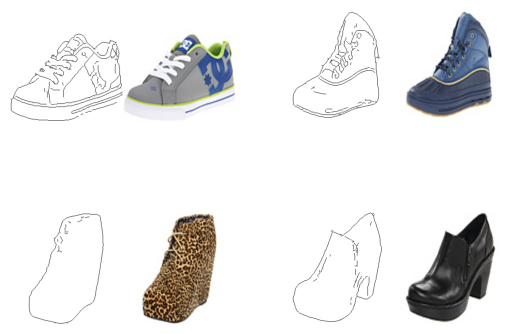

In [4]:
#Sample Output used for visualization
test = test_loader.__iter__().__next__()
img_size = 256
fixed_y_ = test[:, :, :, img_size:].cuda()
fixed_x_ = test[:, :, :, 0:img_size].cuda()
print(len(train_loader))
print(len(test_loader))
print(fixed_y_.shape)

# plot sample image
fig, axes = plt.subplots(2, 2)
axes = np.reshape(axes, (4, ))
for i in range(4):
  example = train_loader.__iter__().__next__()[i].numpy().transpose((1, 2, 0))
  mean = np.array([0.5, 0.5, 0.5])
  std = np.array([0.5, 0.5, 0.5])
  example = std * example + mean
  axes[i].imshow(example)
  axes[i].axis('off')
plt.show()

## Step 2: Build Generator and Discriminator
Based on the paper, the architectures of network are as following:

**Generator architectures:**

U-net encoder:

C64-C128-C256-C512-C512-C512-C512-C512

U-net decoder:

C512-C512-C512-C512-C256-C128-C64-C3

After the last layer in the decoder, a convolution is applied to map to the number of output channels, followed by a Tanh
function. As an exception to the above notation, BatchNorm is not applied to the first C64 layer in the encoder.
All ReLUs in the encoder are leaky, with slope 0.2, while
ReLUs in the decoder are not leaky.

**Discriminator architectures**

The discriminator architecture is:

C64-C128-C256-C512

After the last layer, a convolution is applied to map to
a 1-dimensional output, followed by a Sigmoid function.
As an exception to the above notation, BatchNorm is not
applied to the first C64 layer. All ReLUs are leaky, with
slope 0.2.

We have included a toy example of a U-net architecture below.
Encoder: C64-C128-C256
Decoder: C128-C64-C3

In [5]:
# (Not a part of your solution) Toy example of an U-net architecture
class toy_unet(nn.Module):
  # initializers
  def __init__(self):
    super(generator, self).__init__()
    # encoder
    self.conv1 = nn.Conv2d(3, 64, 4, 2, 1)
    self.conv2 = nn.Conv2d(64, 64 * 2, 4, 2, 1)
    self.conv3 = nn.Conv2d(64 * 2, 64 * 4, 4, 2, 1)
    # decoder
    self.deconv1 = nn.ConvTranspose2d(64 * 4, 64 * 2, 4, 2, 1)
    self.deconv2 = nn.ConvTranspose2d(64 * 2 * 2, 64, 4, 2, 1)
    self.deconv3 = nn.ConvTranspose2d(64 * 2, 3, 4, 2, 1)

  # forward method
  def forward(self, input):
    # pass through encoder
    e1 = self.conv1(input)
    e2 = self.conv2(F.relu(e1))
    e3 = self.conv3(F.relu(e2))
    # pass through decoder
    d1 = self.deconv1(F.relu(e3))
    d1 = torch.cat([d1, e2], 1) # Concatenation
    d2 = self.deconv2(F.relu(d1))
    d2 = torch.cat([d2, e1], 1) # Concatenation
    d3 = self.deconv3(F.relu(d2))
    return d3

In [6]:
def normal_init(m, mean, std):
  """
  Helper function. Initialize model parameter with given mean and std.
  """
  if isinstance(m, nn.ConvTranspose2d) or isinstance(m, nn.Conv2d):
    # delete start
    m.weight.data.normal_(mean, std)
    m.bias.data.zero_()
    # delete end

In [7]:
class generator(nn.Module):
  # initializers
  def __init__(self):
    super(generator, self).__init__()
    ###########################################################################
    # TODO: Build your Unet generator encoder with the layer sizes            #
    # You can also check the size with the model summary below                #
    ###########################################################################
    # encoder
    self.en64_1 = nn.Sequential(
        nn.Conv2d(3, 64, 4, stride=2, padding=1),
        # nn.BatchNorm2d(64)
    )
    self.en128_2 = nn.Sequential(
        nn.Conv2d(64, 128, 4, stride=2, padding=1),
        nn.BatchNorm2d(128)
    )
    self.en256_3 = nn.Sequential(
        nn.Conv2d(128, 256, 4, stride=2, padding=1),
        nn.BatchNorm2d(256)
    )
    self.en512_4 = nn.Sequential(
        nn.Conv2d(256, 512, 4, stride=2, padding=1),
        nn.BatchNorm2d(512)
    )
    self.en512_5 = nn.Sequential(
        nn.Conv2d(512, 512, 4, stride=2, padding=1),
        nn.BatchNorm2d(512)
    )
    self.en512_6 = nn.Sequential(
        nn.Conv2d(512, 512, 4, stride=2, padding=1),
        nn.BatchNorm2d(512)
    )
    self.en512_7 = nn.Sequential(
        nn.Conv2d(512, 512, 4, stride=2, padding=1),
        nn.BatchNorm2d(512)
    )
    self.en512_8 = nn.Sequential(
        nn.Conv2d(512, 512, 4, stride=2, padding=1),
        # nn.BatchNorm2d(512)
    )
    # decoder
    self.de512_1 = nn.Sequential(
        nn.ConvTranspose2d(512, 512, 4, stride=2, padding=1),
        nn.BatchNorm2d(512)
    )
    self.de512_2 = nn.Sequential(
        nn.ConvTranspose2d(1024, 512, 4, stride=2, padding=1),
        nn.BatchNorm2d(512)
    )
    self.de512_3 = nn.Sequential(
        nn.ConvTranspose2d(1024, 512, 4, stride=2, padding=1),
        nn.BatchNorm2d(512)
    )
    self.de512_4 = nn.Sequential(
        nn.ConvTranspose2d(1024, 512, 4, stride=2, padding=1),
        nn.BatchNorm2d(512)
    )
    self.de256_5 = nn.Sequential(
        nn.ConvTranspose2d(1024, 256, 4, stride=2, padding=1),
        nn.BatchNorm2d(256)
    )
    self.de128_6 = nn.Sequential(
        nn.ConvTranspose2d(512, 128, 4, stride=2, padding=1),
        nn.BatchNorm2d(128)
    )
    self.de64_7 = nn.Sequential(
        nn.ConvTranspose2d(256, 64, 4, stride=2, padding=1),
        nn.BatchNorm2d(64)
    )
    self.de3_8 = nn.Sequential(
        nn.ConvTranspose2d(128, 3, 4, stride=2, padding=1)
    )
    ###########################################################################
    #                              END OF YOUR CODE                           #
    ###########################################################################

  # weight_init
  def weight_init(self, mean, std):
    for m in self._modules:
      normal_init(self._modules[m], mean, std)

  # forward method
  def forward(self, input):
    ###########################################################################
    # TODO: Implement the forward pass of generator                           #
    ###########################################################################
    # encoding
    e1 = F.leaky_relu(self.en64_1(input), negative_slope=0.2)
    e2 = F.leaky_relu(self.en128_2(e1), negative_slope=0.2)
    e3 = F.leaky_relu(self.en256_3(e2), negative_slope=0.2)
    e4 = F.leaky_relu(self.en512_4(e3), negative_slope=0.2)
    e5 = F.leaky_relu(self.en512_5(e4), negative_slope=0.2)
    e6 = F.leaky_relu(self.en512_6(e5), negative_slope=0.2)
    e7 = F.leaky_relu(self.en512_7(e6), negative_slope=0.2)
    e8 = F.leaky_relu(self.en512_8(e7), negative_slope=0.2)
    # decoding
    # Hint: you can use torch.cat to concatenate the decoder and the encoder inputs
    d1 = torch.cat([F.relu(self.de512_1(e8)), e7], 1)
    d2 = torch.cat([F.relu(self.de512_2(d1)), e6], 1)
    d3 = torch.cat([F.relu(self.de512_3(d2)), e5], 1)
    d4 = torch.cat([F.relu(self.de512_4(d3)), e4], 1)
    d5 = torch.cat([F.relu(self.de256_5(d4)), e3], 1)
    d6 = torch.cat([F.relu(self.de128_6(d5)), e2], 1)
    d7 = torch.cat([F.relu(self.de64_7(d6)), e1], 1)
    output = torch.tanh(self.de3_8(d7))
    ###########################################################################
    #                              END OF YOUR CODE                           #
    ###########################################################################

    return output

class discriminator(nn.Module):
  # initializers
  def __init__(self):
    super(discriminator, self).__init__()
    ###########################################################################
    # TODO: Build your CNN discriminator with the layer sizes                 #
    ###########################################################################
    self.c64_1 = nn.Sequential(
        nn.Conv2d(6, 64, 4, stride=2, padding=1),
        # nn.BatchNorm2d(64)
    )
    self.c128_2 = nn.Sequential(
        nn.Conv2d(64, 128, 4, stride=2, padding=1),
        nn.BatchNorm2d(128)
    )
    self.c256_3 = nn.Sequential(
        nn.Conv2d(128, 256, 4, stride=2, padding=1),
        nn.BatchNorm2d(256)
    )
    self.c512_4 = nn.Sequential(
        nn.Conv2d(256, 512, 4, stride=1, padding=1),
        nn.BatchNorm2d(512)
    )
    self.c1_5 = nn.Sequential(
        nn.Conv2d(512, 1, 4, stride=1, padding=1),
        # nn.BatchNorm2d(512)
    )
    ###########################################################################
    #                              END OF YOUR CODE                           #
    ###########################################################################

  # weight_init
  def weight_init(self, mean, std):
    for m in self._modules:
      normal_init(self._modules[m], mean, std)

  # forward method
  def forward(self, input):
    ###########################################################################
    # TODO: Implement the forward pass of discriminator                       #
    ###########################################################################
    e1 = F.leaky_relu(self.c64_1(input), negative_slope=0.2)
    e2 = F.leaky_relu(self.c128_2(e1), negative_slope=0.2)
    e3 = F.leaky_relu(self.c256_3(e2), negative_slope=0.2)
    e4 = F.leaky_relu(self.c512_4(e3), negative_slope=0.2)
    x = torch.sigmoid(self.c1_5(e4))
    ###########################################################################
    #                              END OF YOUR CODE                           #
    ###########################################################################

    return x

In [8]:
# print out the model summary
G = generator().cuda()
D = discriminator().cuda()
summary(G, (3, 256, 256))
summary(D, (6, 256, 256))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           3,136
            Conv2d-2          [-1, 128, 64, 64]         131,200
       BatchNorm2d-3          [-1, 128, 64, 64]             256
            Conv2d-4          [-1, 256, 32, 32]         524,544
       BatchNorm2d-5          [-1, 256, 32, 32]             512
            Conv2d-6          [-1, 512, 16, 16]       2,097,664
       BatchNorm2d-7          [-1, 512, 16, 16]           1,024
            Conv2d-8            [-1, 512, 8, 8]       4,194,816
       BatchNorm2d-9            [-1, 512, 8, 8]           1,024
           Conv2d-10            [-1, 512, 4, 4]       4,194,816
      BatchNorm2d-11            [-1, 512, 4, 4]           1,024
           Conv2d-12            [-1, 512, 2, 2]       4,194,816
      BatchNorm2d-13            [-1, 512, 2, 2]           1,024
           Conv2d-14            [-1, 51

In [9]:
D

discriminator(
  (c64_1): Sequential(
    (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  )
  (c128_2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (c256_3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (c512_4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (c1_5): Sequential(
    (0): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)

In [10]:
G

generator(
  (en64_1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  )
  (en128_2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (en256_3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (en512_4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (en512_5): Sequential(
    (0): Conv2d(512, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (en512_6): Sequential(
    (0): Conv2d(512, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  

**Make sure your model architecturees summary from the above cell match with the given architecture below.**

### generator architecture
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
----------------------------------------------------------------
            Conv2d-1         [-1, 64, 128, 128]           3,136
            Conv2d-2          [-1, 128, 64, 64]         131,200
       BatchNorm2d-3          [-1, 128, 64, 64]             256
            Conv2d-4          [-1, 256, 32, 32]         524,544
       BatchNorm2d-5          [-1, 256, 32, 32]             512
            Conv2d-6          [-1, 512, 16, 16]       2,097,664
       BatchNorm2d-7          [-1, 512, 16, 16]           1,024
            Conv2d-8            [-1, 512, 8, 8]       4,194,816
       BatchNorm2d-9            [-1, 512, 8, 8]           1,024
           Conv2d-10            [-1, 512, 4, 4]       4,194,816
      BatchNorm2d-11            [-1, 512, 4, 4]           1,024
           Conv2d-12            [-1, 512, 2, 2]       4,194,816
      BatchNorm2d-13            [-1, 512, 2, 2]           1,024
           Conv2d-14            [-1, 512, 1, 1]       4,194,816
    ConvTranspose2d-15            [-1, 512, 2, 2]       4,194,816
        BatchNorm2d-16            [-1, 512, 2, 2]           1,024
    ConvTranspose2d-17            [-1, 512, 4, 4]       8,389,120
        BatchNorm2d-18            [-1, 512, 4, 4]           1,024
    ConvTranspose2d-19            [-1, 512, 8, 8]       8,389,120
        BatchNorm2d-20            [-1, 512, 8, 8]           1,024
    ConvTranspose2d-21          [-1, 512, 16, 16]       8,389,120
        BatchNorm2d-22          [-1, 512, 16, 16]           1,024
    ConvTranspose2d-23          [-1, 256, 32, 32]       4,194,560
        BatchNorm2d-24          [-1, 256, 32, 32]             512
    ConvTranspose2d-25          [-1, 128, 64, 64]       1,048,704
        BatchNorm2d-26          [-1, 128, 64, 64]             256
    ConvTranspose2d-27         [-1, 64, 128, 128]         262,208
        BatchNorm2d-28         [-1, 64, 128, 128]             128
    ConvTranspose2d-29          [-1, 3, 256, 256]           6,147
----------------------------------------------------------------
    Total params: 54,419,459
    Trainable params: 54,419,459
    Non-trainable params: 0
----------------------------------------------------------------


### discriminator architecture

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
----------------------------------------------------------------
            Conv2d-1         [-1, 64, 128, 128]           6,208
            Conv2d-2          [-1, 128, 64, 64]         131,200
       BatchNorm2d-3          [-1, 128, 64, 64]             256
            Conv2d-4          [-1, 256, 32, 32]         524,544
       BatchNorm2d-5          [-1, 256, 32, 32]             512
            Conv2d-6          [-1, 512, 31, 31]       2,097,664
       BatchNorm2d-7          [-1, 512, 31, 31]           1,024
            Conv2d-8            [-1, 1, 30, 30]           8,193
----------------------------------------------------------------
    Total params: 2,769,601
    Trainable params: 2,769,601
    Non-trainable params: 0
----------------------------------------------------------------


## Step 3: Train

In this section, complete the function train. 
Then train two model: one with only L1 loss, the other with c=100.



In [11]:
# Helper function for showing result.
def process_image(img):
  return (img.cpu().data.numpy().transpose(1, 2, 0) + 1) / 2

def show_result(G, x_, y_, num_epoch):
  predict_images = G(x_)

  fig, ax = plt.subplots(x_.size()[0], 3, figsize=(6,10))

  for i in range(x_.size()[0]):
    ax[i, 0].get_xaxis().set_visible(False)
    ax[i, 0].get_yaxis().set_visible(False)
    ax[i, 1].get_xaxis().set_visible(False)
    ax[i, 1].get_yaxis().set_visible(False)
    ax[i, 2].get_xaxis().set_visible(False)
    ax[i, 2].get_yaxis().set_visible(False)
    ax[i, 0].cla()
    ax[i, 0].imshow(process_image(x_[i]))
    ax[i, 1].cla()
    ax[i, 1].imshow(process_image(predict_images[i]))
    ax[i, 2].cla()
    ax[i, 2].imshow(process_image(y_[i]))
  
  plt.tight_layout()
  label_epoch = 'Epoch {0}'.format(num_epoch)
  fig.text(0.5, 0, label_epoch, ha='center')
  label_input = 'Input'
  fig.text(0.18, 1, label_input, ha='center')
  label_output = 'Output'
  fig.text(0.5, 1, label_output, ha='center')
  label_truth = 'Ground truth'
  fig.text(0.81, 1, label_truth, ha='center')

  plt.show()

# Helper function for counting number of trainable parameters.
def count_params(model):
  '''
  Counts the number of trainable parameters in PyTorch.
  Args:
      model: PyTorch model.
  Returns:
      num_params: int, number of trainable parameters.
  '''
  num_params = sum([item.numel() for item in model.parameters() if item.requires_grad])
  return num_params

In [12]:
# Hint: you could use following loss to complete following function
BCE_loss = nn.BCELoss().cuda()
L1_loss = nn.L1Loss().cuda()

def train(G, D, num_epochs = 20, only_L1 = False):
  hist_D_losses = []
  hist_G_losses = []
  hist_G_L1_losses = []
  ###########################################################################
  # TODO: Add Adam optimizer to generator and discriminator                 #
  # You will use lr=0.0002, beta=0.5, beta2=0.999                           #
  ###########################################################################
  G_optimizer = optim.Adam(G.parameters(), lr=0.0002, betas=(0.5, 0.999))
  D_optimizer = optim.Adam(D.parameters(), lr=0.0002, betas=(0.5, 0.999))
  ###########################################################################
  #                              END OF YOUR CODE                           #
  ###########################################################################

  print('training start!')
  start_time = time.time()
  for epoch in range(num_epochs):
    print('Start training epoch %d' % (epoch + 1))
    D_losses = []
    G_losses = []
    epoch_start_time = time.time()
    num_iter = 0
    for x_ in train_loader:

      y_ = x_[:, :, :, img_size:]
      x_ = x_[:, :, :, 0:img_size]
      
      x_, y_ = x_.cuda(), y_.cuda()
      ###########################################################################
      # TODO: Implement training code for the discriminator.                    #
      # Recall that the loss is the mean of the loss for real images and fake   #
      # images, and made by some calculations with zeros and ones               #
      # We have defined the BCE_loss, which you might would like to use         #
      ###########################################################################
      D.zero_grad()

      G_result = G(x_)
      D_input_fake = torch.cat([x_, G_result], 1)
      D_result_fake = D(D_input_fake).squeeze()
      D_input_real = torch.cat([x_, y_], 1)
      D_result_real = D(D_input_real).squeeze()
      # print(x_.size())
      # print(D_input.size())
      # print(D(D_input).size())
      # print(D_result.size())
      # print(D_result)
      D_train_loss = BCE_loss(D_result_real, torch.ones(D_result_real.size()).cuda()) + BCE_loss(D_result_fake, torch.zeros(D_result_fake.size()).cuda())
      D_train_loss.backward()
      D_optimizer.step()
      loss_D = D_train_loss.detach().item()

      ###########################################################################
      #                              END OF YOUR CODE                           #
      ###########################################################################   

      # Train the generator
      G.zero_grad()

      G_result = G(x_)
      D_input = torch.cat([x_, G_result], 1)
      D_result = D(D_input).squeeze()

      if only_L1:
        G_train_loss = L1_loss(G_result, y_)
        hist_G_losses.append(L1_loss(G_result, y_).detach().item())
      else:
        G_train_loss = BCE_loss(D_result, torch.ones(D_result.size()).cuda()) + 100 * L1_loss(G_result, y_)
        hist_G_L1_losses.append(L1_loss(G_result, y_).detach().item())
        hist_G_losses.append(BCE_loss(D_result, torch.ones(D_result.size()).cuda()).detach().item())
      
      G_train_loss.backward()
      G_optimizer.step()
      loss_G = G_train_loss.detach().item()

      D_losses.append(loss_D)
      hist_D_losses.append(loss_D)
      G_losses.append(loss_G)
      num_iter += 1

    epoch_end_time = time.time()
    per_epoch_ptime = epoch_end_time - epoch_start_time

    print('[%d/%d] - using time: %.2f seconds' % ((epoch + 1), num_epochs, per_epoch_ptime))
    print('loss of discriminator D: %.3f' % (torch.mean(torch.FloatTensor(D_losses))))
    print('loss of generator G: %.3f' % (torch.mean(torch.FloatTensor(G_losses))))
    if epoch == 0 or (epoch + 1) % 5 == 0:
      with torch.no_grad():
        show_result(G, fixed_x_, fixed_y_, (epoch+1))

  end_time = time.time()
  total_ptime = end_time - start_time

  return hist_D_losses, hist_G_losses, hist_G_L1_losses

In this part, train your model with c=100 with at least 20 epochs.

In [13]:
# Define network
G_100 = generator()
D_100 = discriminator()
G_100.weight_init(mean=0.0, std=0.02)
D_100.weight_init(mean=0.0, std=0.02)
G_100.cuda()
D_100.cuda()
G_100.train()
D_100.train()

discriminator(
  (c64_1): Sequential(
    (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  )
  (c128_2): Sequential(
    (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (c256_3): Sequential(
    (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (c512_4): Sequential(
    (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  )
  (c1_5): Sequential(
    (0): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)

training start!
Start training epoch 1
[1/20] - using time: 29.11 seconds
loss of discriminator D: 1.093
loss of generator G: 25.561


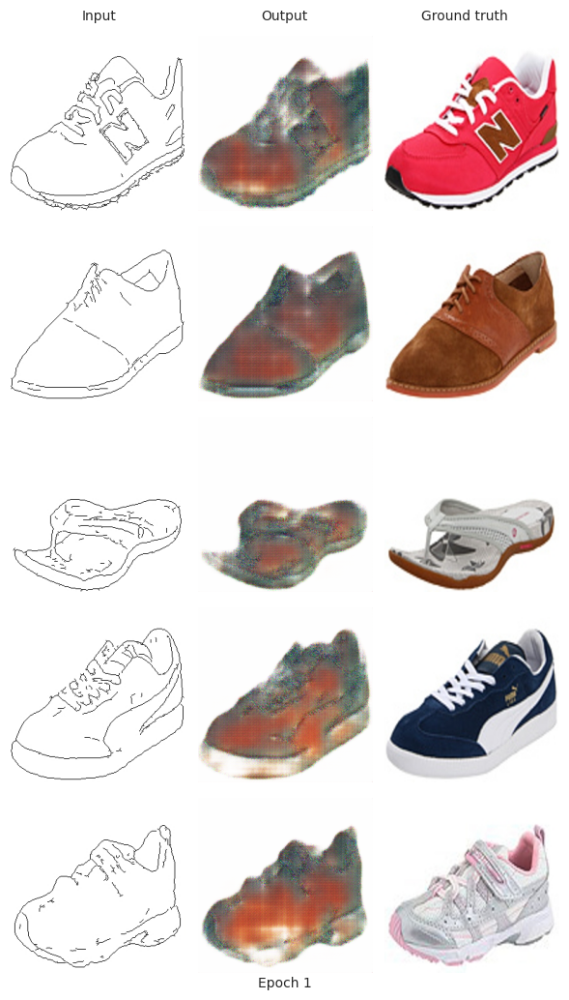

Start training epoch 2
[2/20] - using time: 28.92 seconds
loss of discriminator D: 1.000
loss of generator G: 20.609
Start training epoch 3
[3/20] - using time: 29.11 seconds
loss of discriminator D: 1.001
loss of generator G: 19.654
Start training epoch 4
[4/20] - using time: 29.07 seconds
loss of discriminator D: 1.003
loss of generator G: 18.773
Start training epoch 5
[5/20] - using time: 29.04 seconds
loss of discriminator D: 1.002
loss of generator G: 17.841


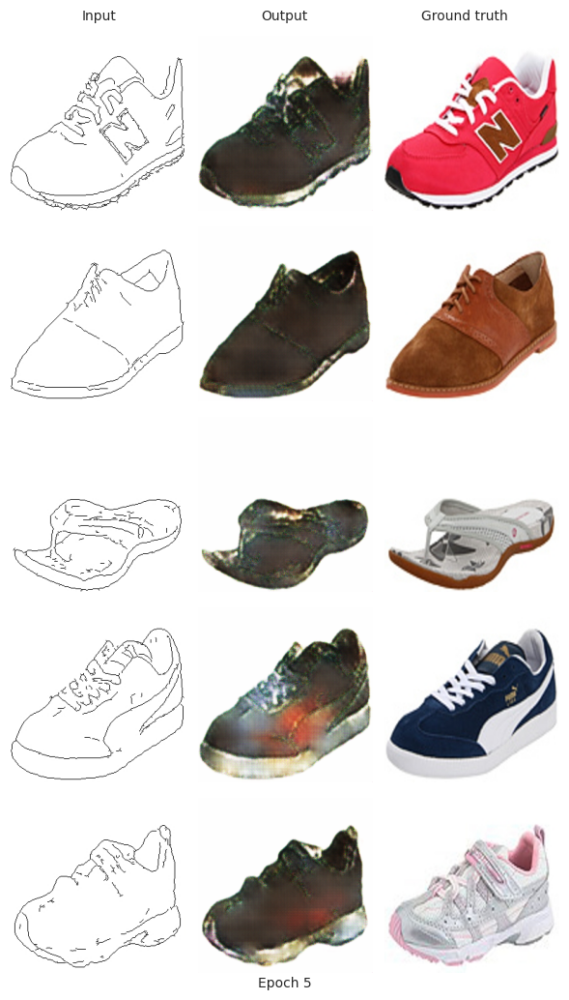

Start training epoch 6
[6/20] - using time: 29.04 seconds
loss of discriminator D: 1.012
loss of generator G: 16.408
Start training epoch 7
[7/20] - using time: 29.00 seconds
loss of discriminator D: 1.014
loss of generator G: 15.683
Start training epoch 8
[8/20] - using time: 29.01 seconds
loss of discriminator D: 1.044
loss of generator G: 14.879
Start training epoch 9
[9/20] - using time: 29.26 seconds
loss of discriminator D: 1.056
loss of generator G: 14.048
Start training epoch 10
[10/20] - using time: 29.26 seconds
loss of discriminator D: 1.042
loss of generator G: 13.593


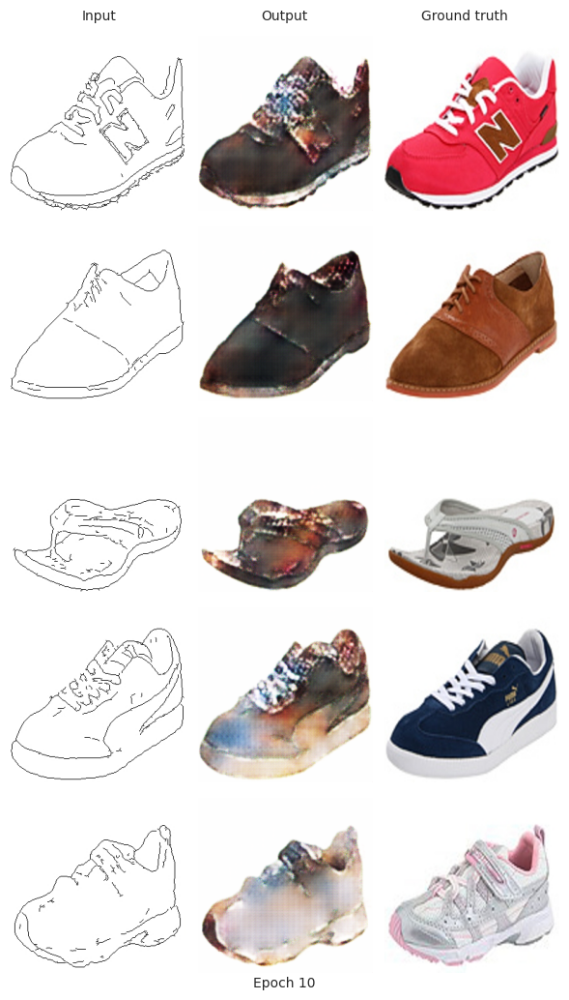

Start training epoch 11
[11/20] - using time: 29.23 seconds
loss of discriminator D: 1.032
loss of generator G: 12.949
Start training epoch 12
[12/20] - using time: 29.37 seconds
loss of discriminator D: 1.040
loss of generator G: 12.271
Start training epoch 13
[13/20] - using time: 29.36 seconds
loss of discriminator D: 1.058
loss of generator G: 11.640
Start training epoch 14
[14/20] - using time: 29.23 seconds
loss of discriminator D: 1.061
loss of generator G: 11.066
Start training epoch 15
[15/20] - using time: 29.15 seconds
loss of discriminator D: 1.086
loss of generator G: 10.672


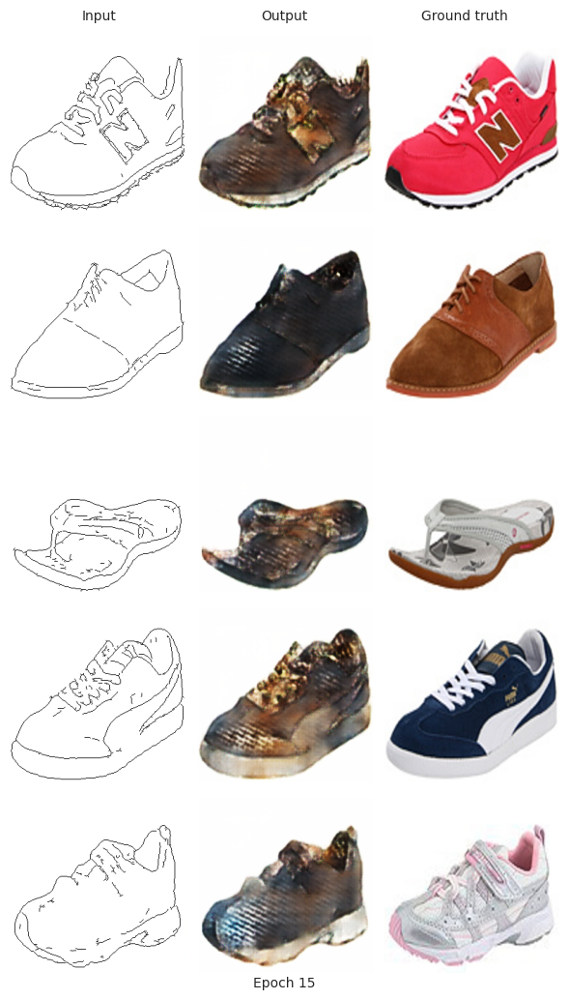

Start training epoch 16
[16/20] - using time: 29.25 seconds
loss of discriminator D: 1.059
loss of generator G: 10.423
Start training epoch 17
[17/20] - using time: 29.17 seconds
loss of discriminator D: 0.998
loss of generator G: 10.312
Start training epoch 18
[18/20] - using time: 29.15 seconds
loss of discriminator D: 0.664
loss of generator G: 11.407
Start training epoch 19
[19/20] - using time: 29.08 seconds
loss of discriminator D: 0.679
loss of generator G: 11.379
Start training epoch 20
[20/20] - using time: 29.08 seconds
loss of discriminator D: 0.779
loss of generator G: 10.865


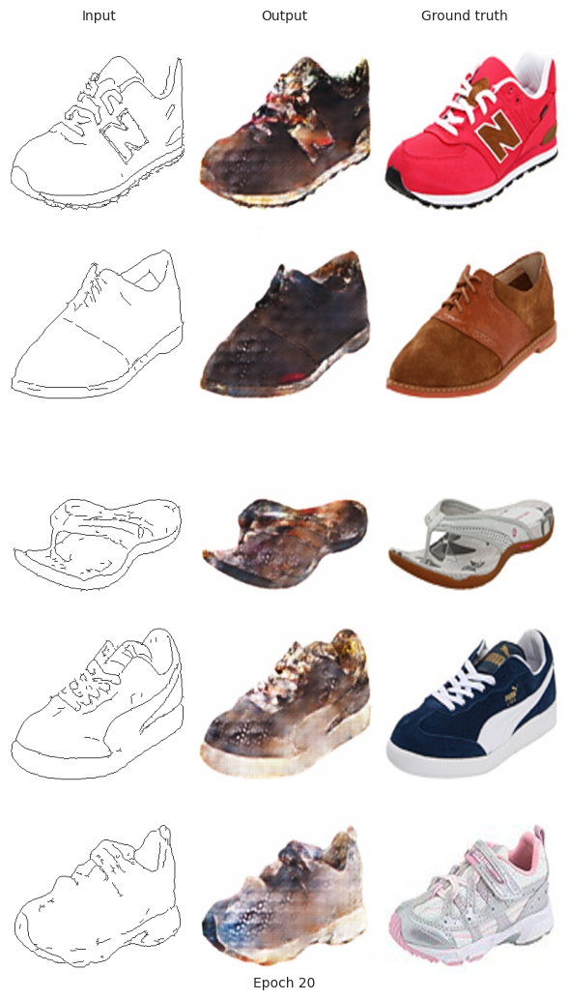

In [14]:
#training, you will be expecting 1-2 minutes per epoch.
# TODO: change_num_epochs if you want
hist_D_100_losses, hist_G_100_BCE_losses, hist_G_100_L1_losses = train(G_100, D_100, num_epochs = 20, only_L1 = False)

In [15]:
!mkdir models
torch.save(G_100.state_dict(), './models/G_100.pth')
torch.save(D_100.state_dict(), './models/D_100.pth')

mkdir: cannot create directory ‘models’: File exists


In this part, train your model with only L1 loss with 10 epochs.

training start!
Start training epoch 1
[1/10] - using time: 27.68 seconds
loss of discriminator D: 0.826
loss of generator G: 0.253


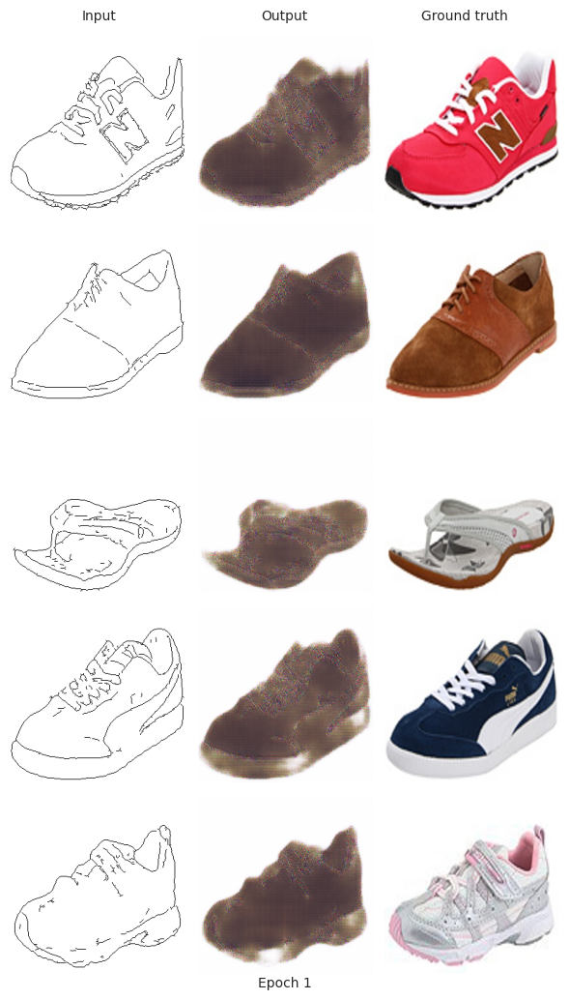

Start training epoch 2
[2/10] - using time: 27.11 seconds
loss of discriminator D: 0.898
loss of generator G: 0.184
Start training epoch 3
[3/10] - using time: 27.05 seconds
loss of discriminator D: 0.293
loss of generator G: 0.174
Start training epoch 4
[4/10] - using time: 26.89 seconds
loss of discriminator D: 0.153
loss of generator G: 0.165
Start training epoch 5
[5/10] - using time: 26.99 seconds
loss of discriminator D: 0.222
loss of generator G: 0.157


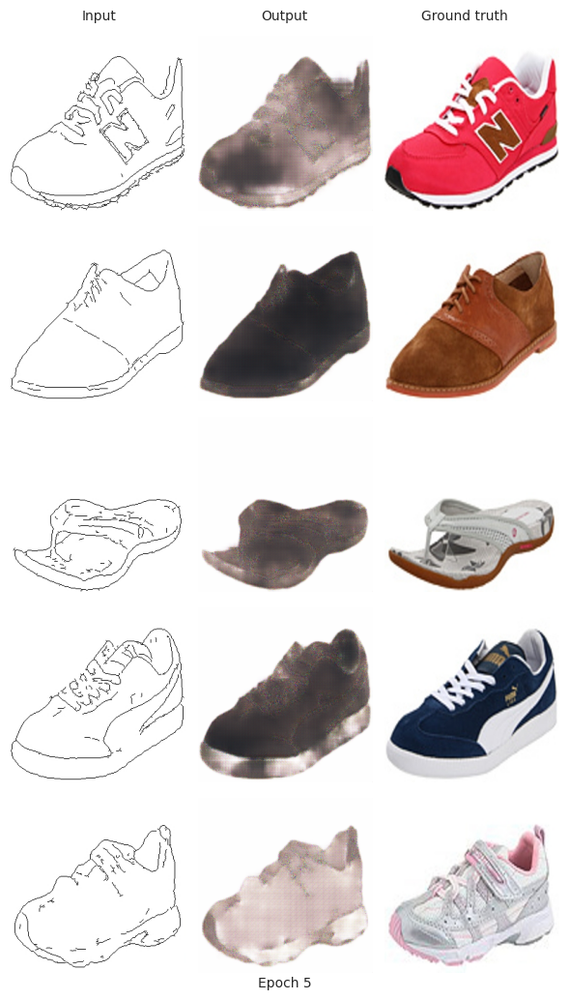

Start training epoch 6
[6/10] - using time: 26.88 seconds
loss of discriminator D: 0.021
loss of generator G: 0.151
Start training epoch 7
[7/10] - using time: 26.84 seconds
loss of discriminator D: 0.148
loss of generator G: 0.142
Start training epoch 8
[8/10] - using time: 26.93 seconds
loss of discriminator D: 0.024
loss of generator G: 0.136
Start training epoch 9
[9/10] - using time: 26.94 seconds
loss of discriminator D: 0.004
loss of generator G: 0.128
Start training epoch 10
[10/10] - using time: 26.96 seconds
loss of discriminator D: 0.002
loss of generator G: 0.123


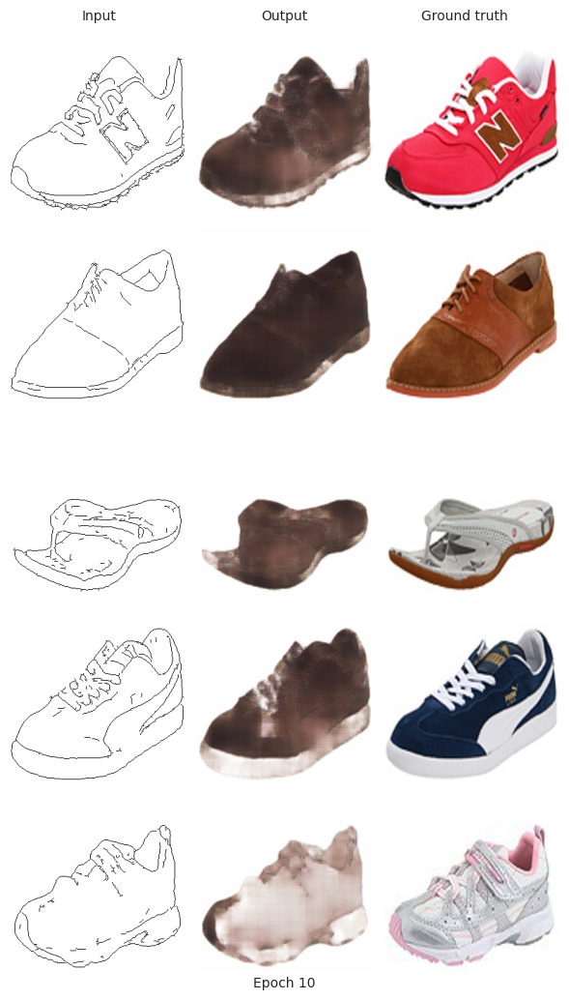

In [16]:
# Define network
G_L1 = generator()
D_L1 = discriminator()
G_L1.weight_init(mean=0.0, std=0.02)
D_L1.weight_init(mean=0.0, std=0.02)
G_L1.cuda()
D_L1.cuda()
G_L1.train()
D_L1.train()

# training
hist_D_L1_losses, hist_G_L1_losses, _ = train(G_L1, D_L1, num_epochs = 10, only_L1 = True)

In [17]:
torch.save(G_L1.state_dict(), './models/G_L1.pth')
torch.save(D_L1.state_dict(), './models/D_L1.pth')

### **TODO**: Please comment on the quality of generated images from L1+cGAN and L1 only:

***The quality of images generated from L1+cGAN are visually much better then those from L1 loss only, especially the color!***

## Step 4: Visualization



Please plot the generator BCE and L1 losses, as well as the discriminator loss. For this, please use c=100, and use 3 separate plots.

/tmp/ipykernel_30522/1002691555.py:13: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f0.show()
/tmp/ipykernel_30522/1002691555.py:17: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f1.show()
/tmp/ipykernel_30522/1002691555.py:21: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f2.show()
/tmp/ipykernel_30522/1002691555.py:25: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f3.show()


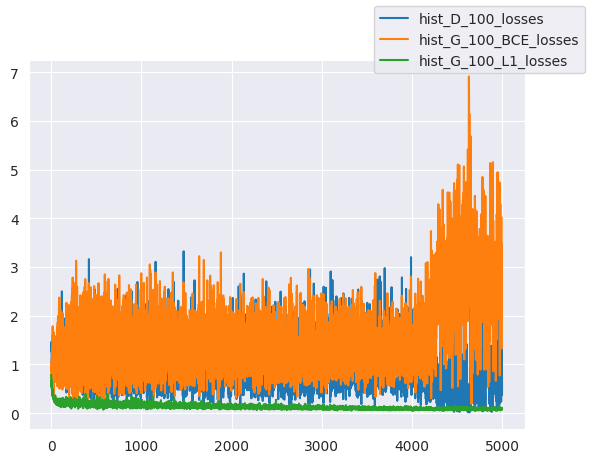

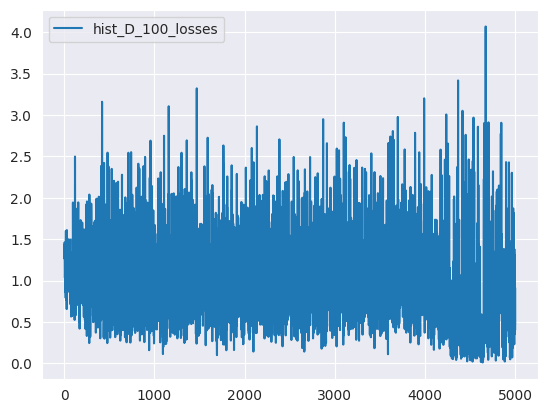

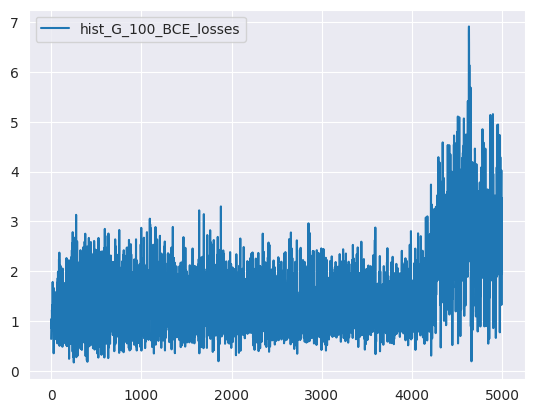

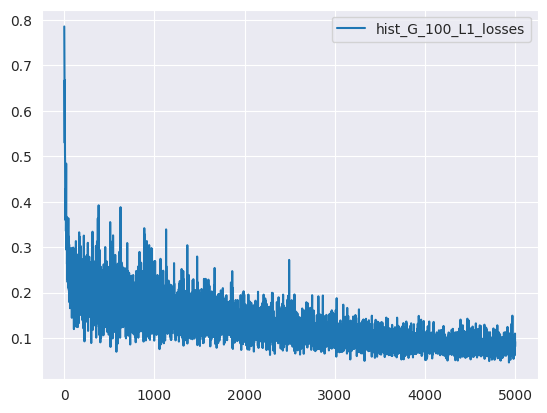

In [18]:
###########################################################################
# TODO: Plot the G/D loss history (y axis) vs. Iteration (x axis)         #
# You will have three plots, with hist_D_100_losses,                      #
# hist_G_100_BCE_losses, hist_G_100_L1_losses respectively.               #
# Hiint: Use plt.legend if you want visualize the annotation for your     #
# curve                                                                   #
###########################################################################
f0 = plt.figure()
plt.plot(np.arange(len(hist_D_100_losses)), hist_D_100_losses)
plt.plot(np.arange(len(hist_G_100_BCE_losses)), hist_G_100_BCE_losses)
plt.plot(np.arange(len(hist_G_100_L1_losses)), hist_G_100_L1_losses)
f0.legend(['hist_D_100_losses', 'hist_G_100_BCE_losses', 'hist_G_100_L1_losses'])
f0.show()
f1 = plt.figure()
plt.plot(np.arange(len(hist_D_100_losses)), hist_D_100_losses)
plt.legend(['hist_D_100_losses'])
f1.show()
f2 = plt.figure()
plt.plot(np.arange(len(hist_G_100_BCE_losses)), hist_G_100_BCE_losses)
plt.legend(['hist_G_100_BCE_losses'])
f2.show()
f3 = plt.figure()
plt.plot(np.arange(len(hist_G_100_L1_losses)), hist_G_100_L1_losses)
plt.legend(['hist_G_100_L1_losses'])
f3.show()
###########################################################################
#                              END OF YOUR CODE                           #
########################################################################### 

[In this section, plot the G/D loss history vs. Iteration of model with only L1 loss in 2 seperate plots.

/tmp/ipykernel_30522/3155941410.py:10: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f0.show()
/tmp/ipykernel_30522/3155941410.py:14: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f1.show()
/tmp/ipykernel_30522/3155941410.py:18: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  f2.show()


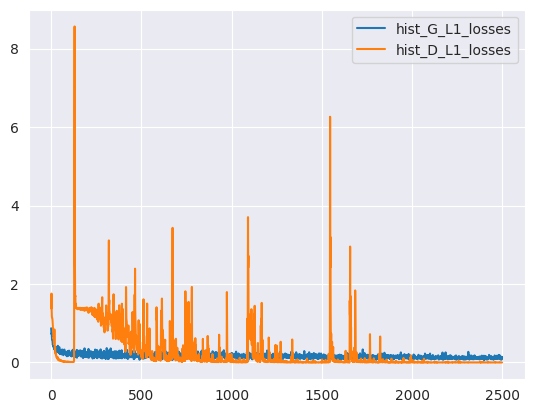

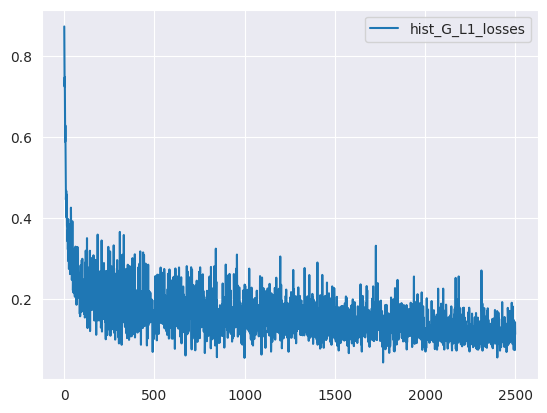

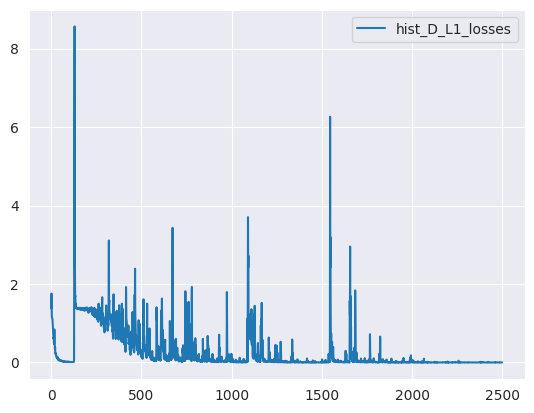

In [19]:
###########################################################################
# TODO: Plot the G/D loss history vs. Iteration in one plot               #
# You will have two plots, with hist_G_L1_losses and hist_D_L1_losses     #
# respectively                                                            #
###########################################################################
f0 = plt.figure()
plt.plot(np.arange(len(hist_G_L1_losses)), hist_G_L1_losses)
plt.plot(np.arange(len(hist_D_L1_losses)), hist_D_L1_losses)
plt.legend(['hist_G_L1_losses', 'hist_D_L1_losses'])
f0.show()
f1 = plt.figure()
plt.plot(np.arange(len(hist_G_L1_losses)), hist_G_L1_losses)
plt.legend(['hist_G_L1_losses'])
f1.show()
f2 = plt.figure()
plt.plot(np.arange(len(hist_D_L1_losses)), hist_D_L1_losses)
plt.legend(['hist_D_L1_losses'])
f2.show()
###########################################################################
#                              END OF YOUR CODE                           #
###########################################################################

### **TODO**: Please comment on the loss plots for L1+cGAN and L1 only models:

***I run the training several times, generally it's quite obvious that the L1 only Loss decrease over time, while the trend od BCE Loss is bot that obvious, sometimes I can see the general trend goes up obviously, sometimes ( just like this time), the trend is not that obvious, but BCE Loss always goes up and down alternately***

Solution: For the c=100 model, the BCE loss alternates between going up and down and trends slightly upwards over the iterations. The L1 losses steadily goes down. 
For the L1 only model, both G/D losses decrease over the iterations, the Discriminator losses fluctuates.

# Problem 6.2 calculating receptive field size

Please write down the receptive field size in in this text cell. The receptive field size is calculated with:

 $$r_i = r_{i-1} + ((k_i - 1) * \prod_{j=0}^{i-1}s_j)$$

where $k$ is the kernel size of current layer, $s_j$ is the stride of $j^{th}$ layer, and $r_i$ is the receptive field size of $i^{th}$ layer.

We have $r_0 = 1, s_0 = 1$. The kernel size for all layers in the discriminator is 4, and the stride is 2.

The receptive of C64, C128, C256, C512 is $r_1, r_2, r_3, r_4$ respectively. 

__Please directly replace $?$ with you answer in the expression below.__

$$ Input $$
$$ \downarrow $$
$$ C64 (r_1) (\text{receptive field size} = 4) $$
$$ \downarrow $$
$$ C128(r_2)(\text{receptive field size}= 10) $$
$$ \downarrow $$
$$ C256(r_3)(\text{receptive field size}= 22) $$
$$ \downarrow $$
$$ C512(r_4)(\text{receptive field size}= 46) $$

# Problem 6.3 style transfer (EECS 504)


## Step 0: Downloading the dataset and backbone network.
For this problem, we will use five images as our artistic style, and the Coco validation set as our content image.

A pretrained SqueezeNet will be applied to extract features.

In [20]:
if os.path.isdir('styles') and os.path.isdir('contents'):
  print('Style images exist')
else:
  print('Downloading images')
  # Download style images
  !wget https://eecs.umich.edu/courses/eecs442-ahowens/fa22/data/style_images.zip
  !unzip style_images.zip && rm style_images.zip

  # Download content images
  !wget http://images.cocodataset.org/zips/val2017.zip
  !unzip -q val2017.zip && rm val2017.zip
  !mkdir contents
  !mv val2017/* ./contents/

# Download the model
cnn = torchvision.models.squeezenet1_1(pretrained=True).features
cnn = cnn.to(device)

# Freeze the parameters as there's no need to train the net. Ignore the warnings.
for param in cnn.parameters():
    param.requires_grad = False

Style images exist


## STEP 1: Create the image loader and some utility funtions
We provide the dataloader for images and a function to get the list of feature maps from a forward pass in the network.

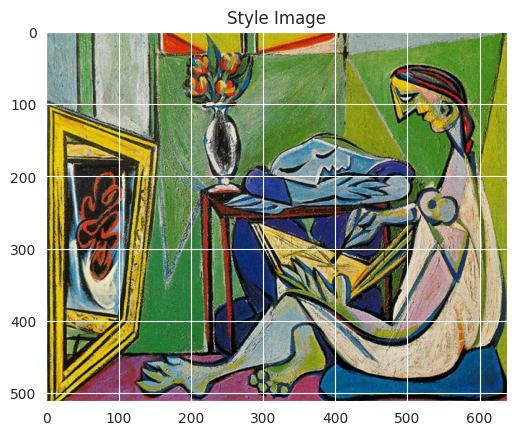

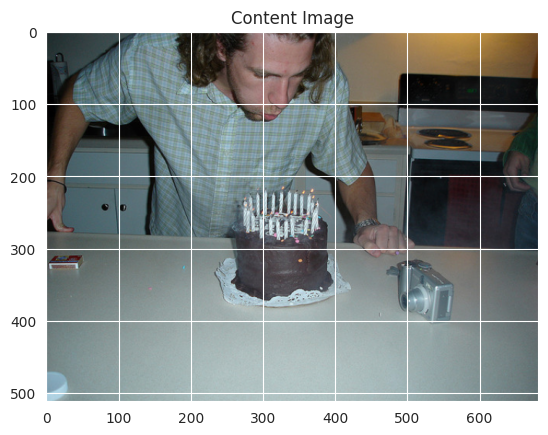

In [21]:
# Dataloader
imsize = 512

SQUEEZENET_MEAN = torch.tensor([0.485, 0.456, 0.406], dtype=torch.float)
SQUEEZENET_STD = torch.tensor([0.229, 0.224, 0.225], dtype=torch.float)


def image_loader(image_name, imsize):
    image = Image.open(image_name)
    transform = transforms.Compose([
                transforms.Resize(imsize),
                transforms.ToTensor(),
                transforms.Normalize(mean=SQUEEZENET_MEAN.tolist(), std=SQUEEZENET_STD.tolist()),
                transforms.Lambda(lambda x: x[None]),
                ])
    image = transform(image)
    return image.to(device, torch.float)

# visualizing the content and style images

style_img = image_loader("styles/muse.jpg", imsize)
content_img = image_loader("contents/000000211825.jpg", imsize)

def deprocess(img):
    transform = transforms.Compose(
        [
            transforms.Lambda(lambda x: x[0]),
            transforms.Normalize(mean=[0, 0, 0], std=(1.0 / SQUEEZENET_STD).tolist()),
            transforms.Normalize(mean=(-SQUEEZENET_MEAN).tolist(), std=[1, 1, 1]),
            transforms.Lambda(lambda x: x),
            transforms.ToPILImage(),
        ]
    )
    return transform(img)

plt.ion()

def imshow(im_tensor, title=None):
    image = im_tensor.cpu().clone()    
    image = deprocess(image)
    plt.imshow(image)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)


plt.figure()
imshow(style_img, title='Style Image')

plt.figure()
imshow(content_img, title='Content Image')

In [22]:
def get_feature_maps(x, cnn):
    """
    Get the list of feature maps in a forward pass.
    
    Inputs:
    - x: A batch of images with shape (B, C, H, W)
    - cnn: A PyTorch model that we will use to extract features.
    
    Returns:
    - features: A list of features for the input images x extracted using the cnn model.
      features[i] is a Tensor of shape (B, C_i, H_i, W_i).
    """
    feats = []
    in_feat = x
    for layer in cnn._modules.values():
        out_feat = layer(in_feat)
        feats.append(out_feat)
        in_feat = out_feat
    return feats

## Step 2: Implementing content loss
First, we will implement the {\em content loss}. This loss encourages the generated image to match the scene structure of the content image. We will implement this loss as the squared $\ell_2$ distance between two convolutional feature maps. Given a feature map of input image $F^x$ and the feature map of content image $F^{c}$, both of shape $(C, H, W)$, the content loss is calculated as follows:

\begin{equation}
\mathcal{L}_c = \sum_{c,i,j}(F^{c}_{c, i, j} - F^{x}_{c, i, j}) ^ 2. 
\end{equation}

In [23]:
def content_loss(f_x, f_con):
    """
    Compute the gram matrix without loop.
    
    Inputs:
    - f_x: features of the input image with size (1, C, H, W).
    - f_con: features of the content image with size (1, C, H, W).
    Returns:
    - lc: the content loss
    """

    lc = None

    ###########################################################################
    # TODO: Implement the content loss.                                       #
    # You can check your content loss with some code blocks below             #
    ###########################################################################
    lc = torch.sum((f_x[0, :, :, :] - f_con[0, :, :, :])**2)
    ###########################################################################
    #                              END OF YOUR CODE                           #
    ###########################################################################

    return lc


## Step 3: Implementing style loss
Next, we will implement the {\em style loss}. This loss encourages the texture of the resulting image to match the input style image. We compute a weighted, squared $\ell_2$ distance between Gram matrices for several layers of the network.

The first step is to calculate the Gram matrix. Given a feature map $F$ of size $(C, H, W)$, the Gram matrix $G \in \mathbb{R}^{C \times C}$ computes the sum of products between channels. The entries $k, l$ of the matrix are computed as:
\begin{equation}
G_{k,l} = \sum_{i,j} F_{k,i,j} F_{l,i,j}.
\end{equation}

The second step is to compare the generated image's Gram matrix with that of the input style image. Define the Gram matrix of input image feature map and style image feature map of at the $l^{th}$ layer as $G^{x,l}$ and $G^{s, l}$, and the weight of the layer as $w^l$. Style loss at the $l^{th}$ layer is
\begin{equation}
L_s^l = w^l \sum_{i,j} (G^{x,l}_{i,j} - G^{s, l}_{i,j})^2,
\end{equation}
where $w^l$ is the weight of layer $l$. The total style loss is a sum over all style layers:
\begin{equation}
    \mathcal{L}_s = \sum_l L_s^l.
\end{equation}

In [24]:
def gram_matrix(feat, normalize = True):
    """
    Compute the gram matrix.
    
    Inputs:
    - feat: a feature tensor of shape (1, C, H, W).
    - normalize: if normalize is true, divide the gram matrix by C*H*W:
    Returns
    - gram: the tram matrix
    """

    gram = torch.zeros((1, feat.shape[1], feat.shape[1]))
    ###########################################################################
    # TODO: Implement the gram matrix. You should not use a loop or           #
    # comprehension                                                           #
    # You can check your style loss with some code blocks below               #
    ###########################################################################
    for i in range(feat.shape[1]):
        for j in range(i + 1):
            gram[0, i, j] = torch.sum(torch.mul(feat[0, i, :, :], feat[0, j, :, :]))
            if i != j:
                gram[0, j, i] = gram[0, i, j]
    if normalize:
        gram = gram / (feat.shape[1]*1.0) / (feat.shape[2]*1.0) / (feat.shape[3]*1.0)
    ###########################################################################
    #                              END OF YOUR CODE                           #
    ###########################################################################

    return gram

In [25]:
# Test your gram matrix, you should be expecting a difference smaller than 0.001
t1 = torch.arange(8).reshape(1,2,2,2)
result = torch.tensor([[[ 1.7500,  4.7500],[ 4.7500, 15.7500]]])
print(((gram_matrix(t1) - result)**2).sum().item())

0.0


In [26]:
def style_loss(feats, style_layers, style_targets, style_weights):
    """
    Computes the style loss at a set of layers.
    
    Inputs:
    - feats: list of the features at every layer of the current image, as produced by
      the extract_features function. The list will contain the features of all layers 
      instead of the layers for calcculating style loss
    - style_layers: List of layer indices into feats giving the layers to include in the
      style loss.
    - style_targets: List of the same length as style_layers, where style_targets[i] is
      a PyTorch Tensor giving the Gram matrix of the source style image computed at
      layer style_layers[i].
    - style_weights: List of the same length as style_layers, where style_weights[i]
      is a scalar giving the weight for the style loss at layer style_layers[i].
      
    Returns:
    - style_loss: A PyTorch Tensor holding a scalar giving the style loss.
    """

    loss = None

    ###########################################################################
    # TODO: Implement the gram matrix. You should not use a loop or           #
    # comprehension                                                           #
    ###########################################################################
    count = 0
    for i in range(len(style_layers)):
        count += 1
        if count == 1:
            loss = style_weights[i] * torch.sum(((style_targets[i] - gram_matrix(feats[style_layers[i]])) ** 2))
        else:
            loss += style_weights[i] * torch.sum(((style_targets[i] - gram_matrix(feats[style_layers[i]])) ** 2))
    ###########################################################################
    #                              END OF YOUR CODE                           #
    ###########################################################################

    return loss

## Step 4: Network Training
Test out your style transfer!

In [46]:
def style_transfer(content_image, style_image, image_size, style_size, content_layer, content_weight,
                   style_layers, style_weights, init_random = False):
    """
    Run style transfer!
    
    Inputs:
    - content_image: filename of content image
    - style_image: filename of style image
    - image_size: size of smallest image dimension (used for content loss and generated image)
    - style_size: size of smallest style image dimension
    - content_layer: layer to use for content loss
    - content_weight: weighting on content loss
    - style_layers: list of layers to use for style loss
    - style_weights: list of weights to use for each layer in style_layers
    - init_random: initialize the starting image to uniform random noise
    """
    
    # Extract features for the content image
    content_img = image_loader(content_image, image_size)
    feats = get_feature_maps(content_img, cnn)
    content_target = feats[content_layer].clone()

    # Extract features for the style image
    style_img = image_loader(style_image, style_size)
    feats = get_feature_maps(style_img, cnn)
    style_targets = []

    for idx in style_layers:
        style_targets.append(gram_matrix(feats[idx].clone()))

    # Initialize output image to content image or nois
    if init_random:
        img = torch.Tensor(content_img.size()).uniform_(0, 1).to(device)
    else:
        img = content_img.clone().to(device)

    # We do want the gradient computed on our image!
    img.requires_grad_()
    
    # Set up optimization hyperparameters
    initial_lr = 1
    decayed_lr = 0.1
    decay_lr_at = 180

    # Note that we are optimizing the pixel values of the image by passing
    # in the img Torch tensor, whose requires_grad flag is set to True
    optimizer = torch.optim.Adam([img], lr=initial_lr)
    
    plt.figure()
    imshow(style_img, title='Style Image')

    plt.figure()
    imshow(content_img, title='Content Image')
    
    for t in range(200):
        if t < 190:
            img.data.clamp_(-1.5, 1.5)
        optimizer.zero_grad()

        feats = get_feature_maps(img, cnn)
        
        # Compute loss
        c_loss = content_loss(feats[content_layer], content_target) * content_weight
        s_loss = style_loss(feats, style_layers, style_targets, style_weights)
        loss = c_loss + s_loss
        
        loss.backward()

        # Perform gradient descents on our image values
        if t == decay_lr_at:
            optimizer = torch.optim.Adam([img], lr=decayed_lr)
        optimizer.step()
        # print("~~~~~~Style Transfer Loop No."+str(t)+"~~~~~~")
        if t % 100 == 0:
            print('Iteration {}'.format(t))
            plt.figure()
            imshow(img, title='Transferred Image')
            plt.show()
    print('Iteration {}'.format(t))
    plt.figure()
    imshow(img, title='Final transferred Image')


In [47]:
# Check of content loss. Ignore the style image.
params_content_check = {
    'content_image':'contents/000000211825.jpg',
    'style_image':'styles/muse.jpg',
    'image_size':192,
    'style_size':512,
    'content_layer':2,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[0, 0, 0, 0],
    'init_random': True
}

style_transfer(**params_content_check)

RuntimeError: CUDA error: unspecified launch failure
CUDA kernel errors might be asynchronously reported at some other API call,so the stacktrace below might be incorrect.
For debugging consider passing CUDA_LAUNCH_BLOCKING=1.

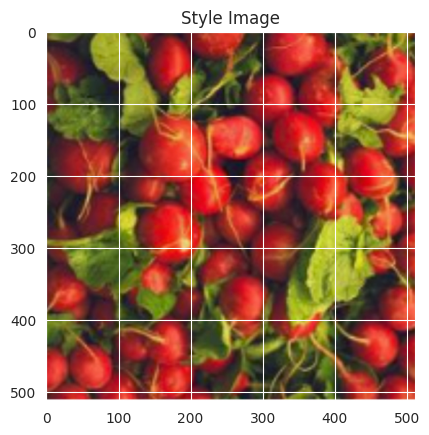

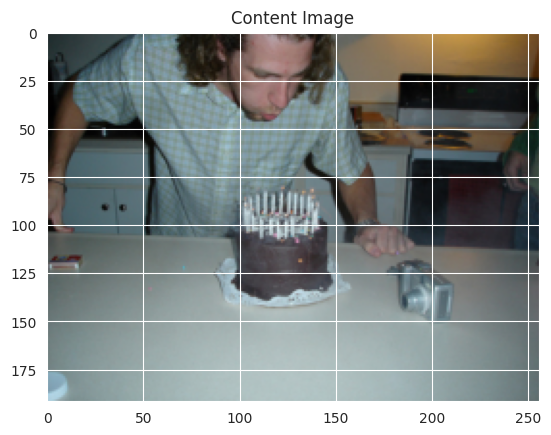

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


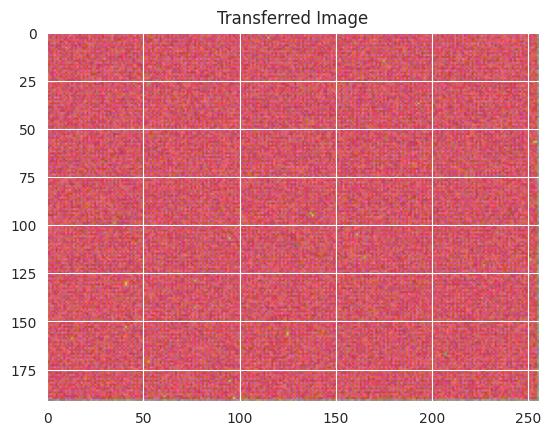

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

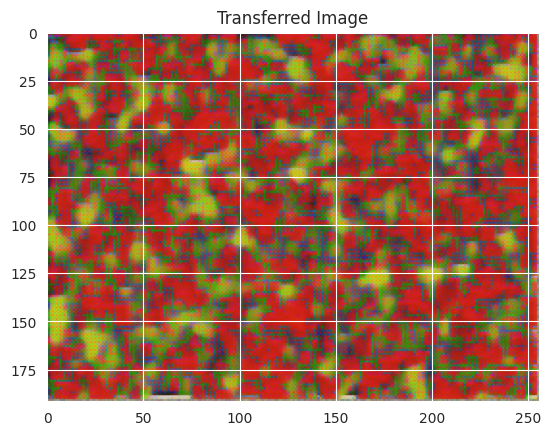

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

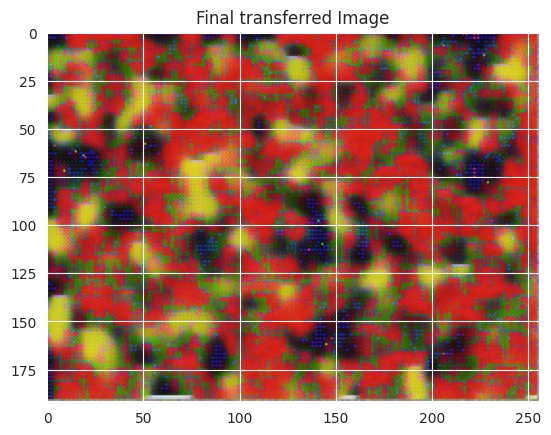

In [29]:
# Check of style loss. You should see the texture of the image. Ignore the content image.
params_style_check = {
    'content_image':'contents/000000211825.jpg',
    'style_image':'styles/texture.jpg',
    'image_size':192,
    'style_size':512,
    'content_layer':2,
    'content_weight':0,
    'style_layers':[0, 1],
    'style_weights':[200000, 200000],
    'init_random': True
}

style_transfer(**params_style_check)

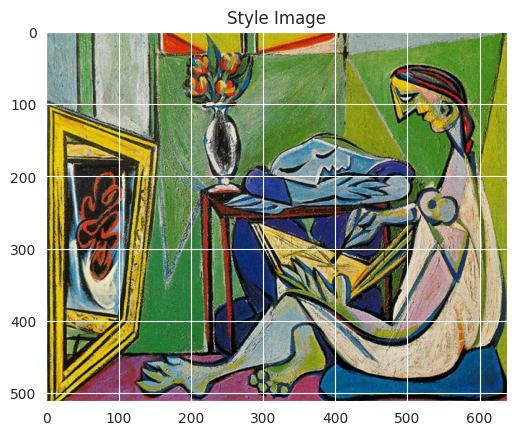

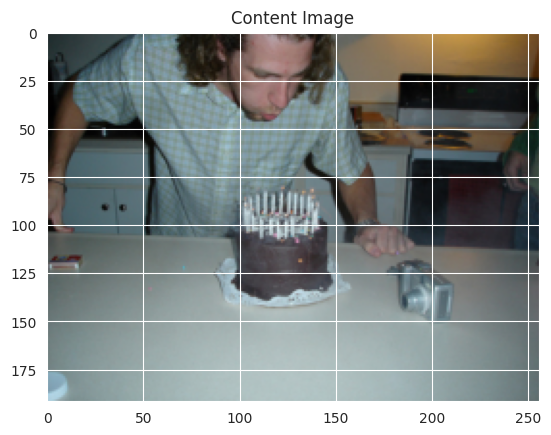

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


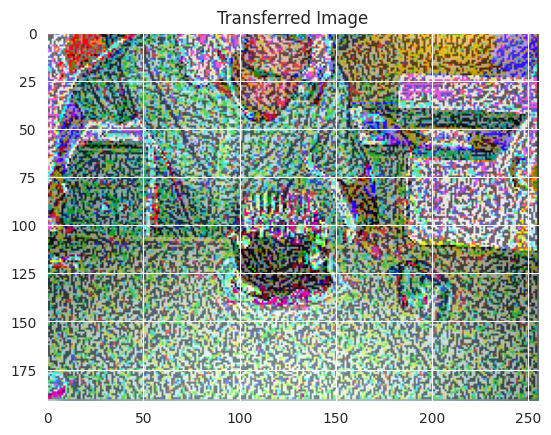

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

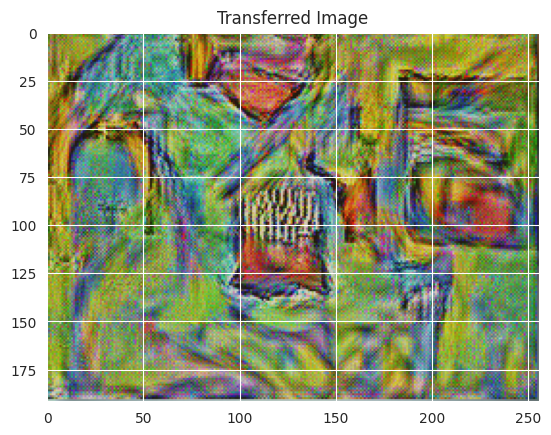

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

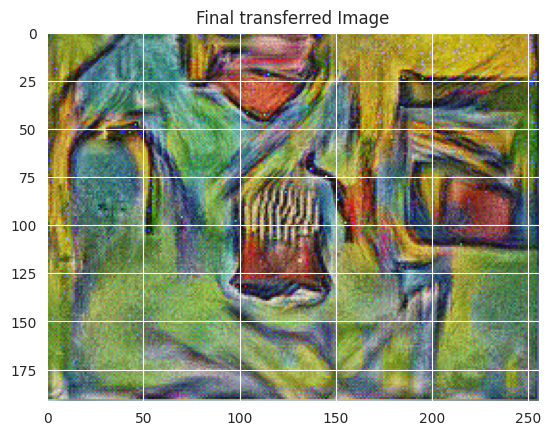

In [30]:
params1 = {
    'content_image':'contents/000000211825.jpg',
    'style_image':'styles/muse.jpg',
    'image_size':192,
    'style_size':512,
    'content_layer':2,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params1)

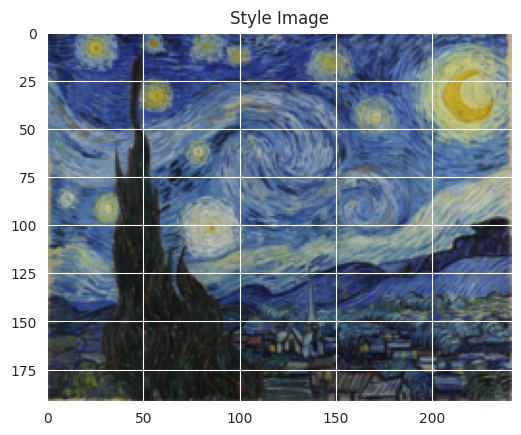

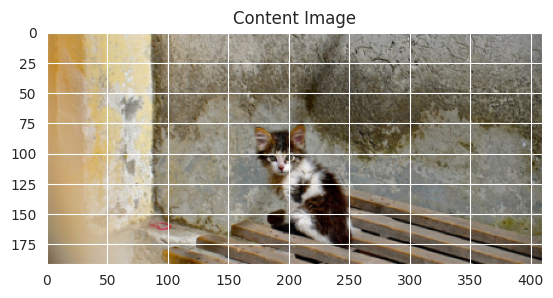

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


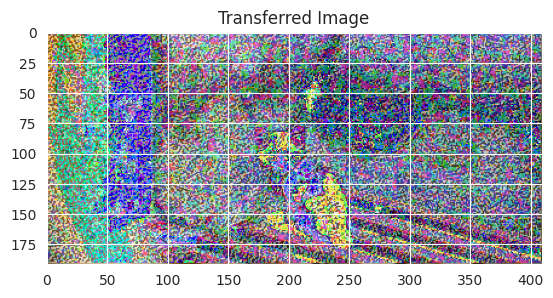

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

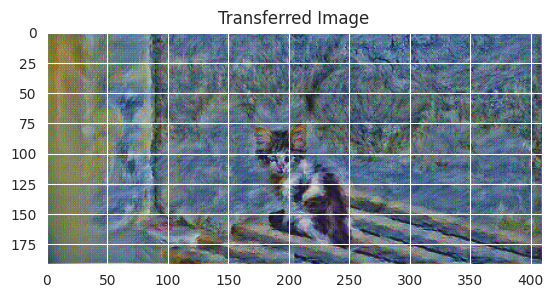

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

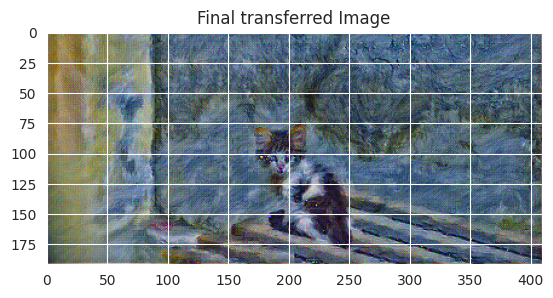

In [31]:
params2 = {
    'content_image':'contents/000000118515.jpg',
    'style_image':'styles/starry_night.jpg',
    'image_size':192,
    'style_size':192,
    'content_layer':3,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params2)

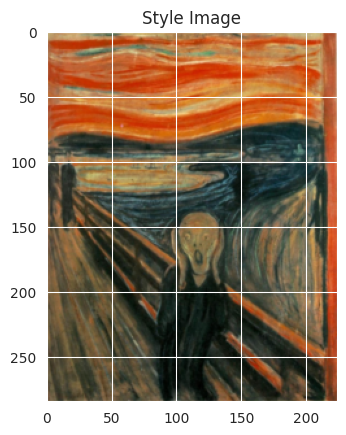

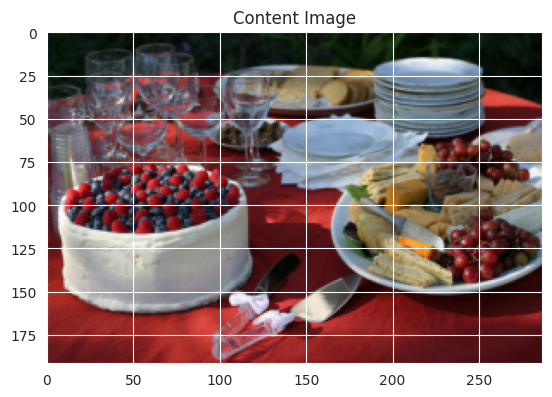

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


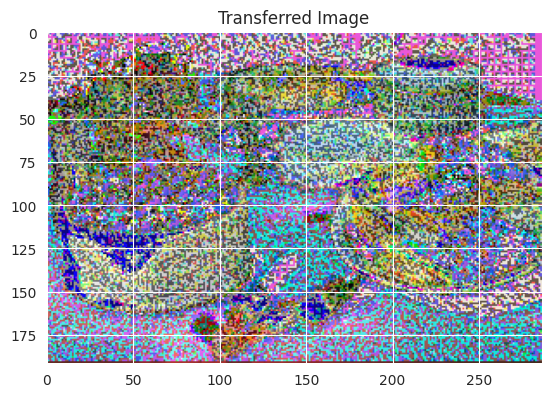

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

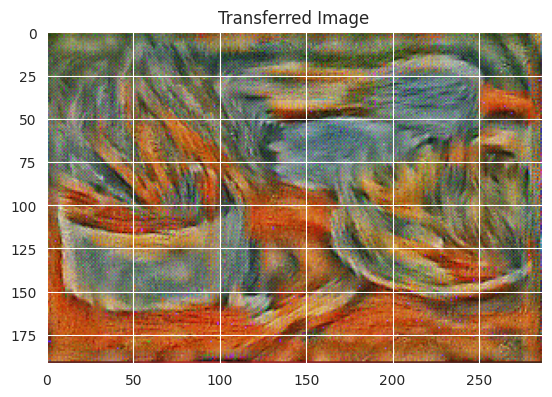

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

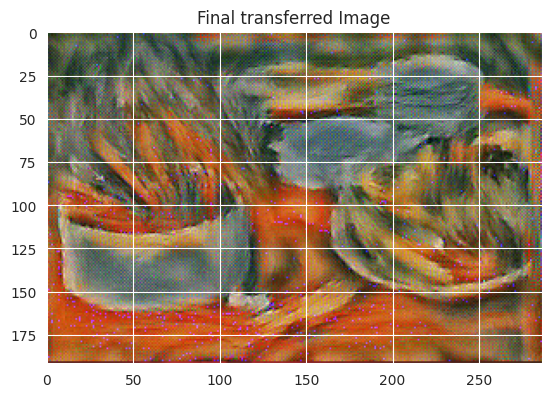

In [32]:
params3 = {
    'content_image':'contents/000000002157.jpg',
    'style_image':'styles/the_scream.jpg',
    'image_size':192,
    'style_size':224,
    'content_layer':2,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params3)

# Feel free ot change the images and get your own style transferred image

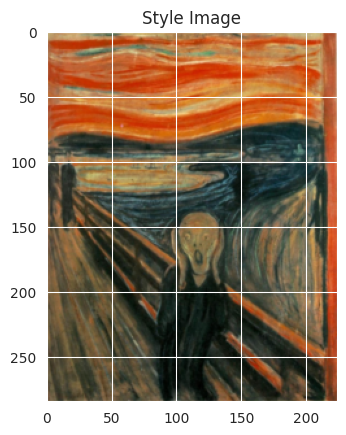

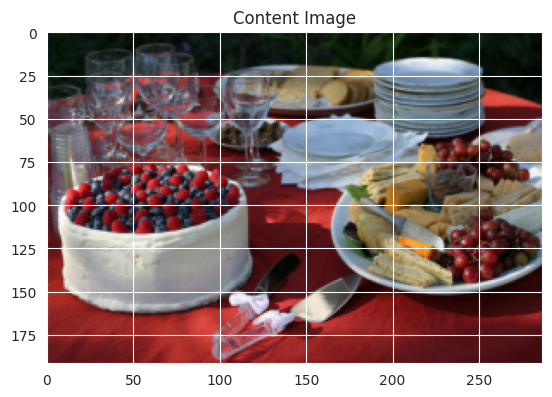

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


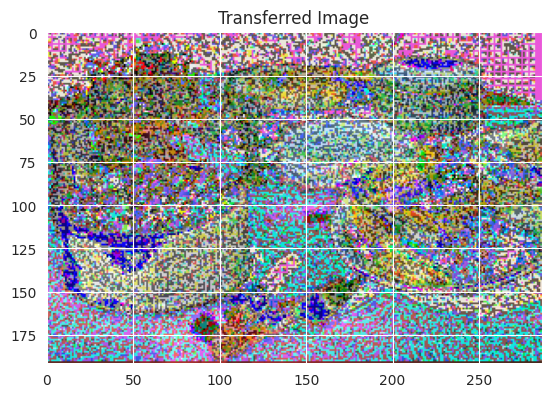

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

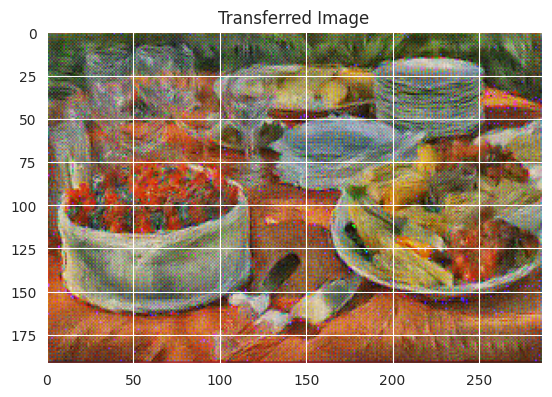

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

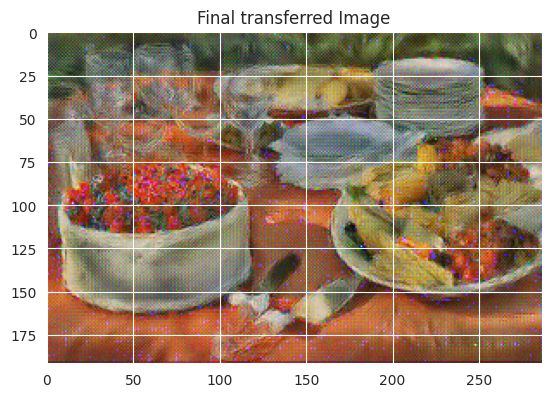

In [38]:
params4 = {
    'content_image':'contents/000000002157.jpg',
    'style_image':'styles/the_scream.jpg',
    'image_size':192,
    'style_size':224,
    'content_layer':4,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params4)

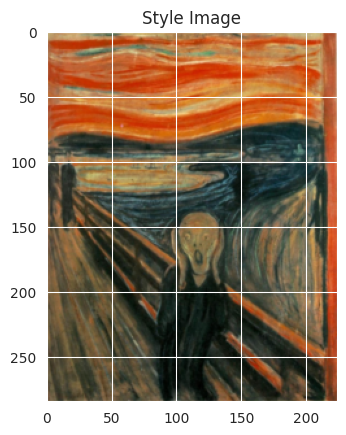

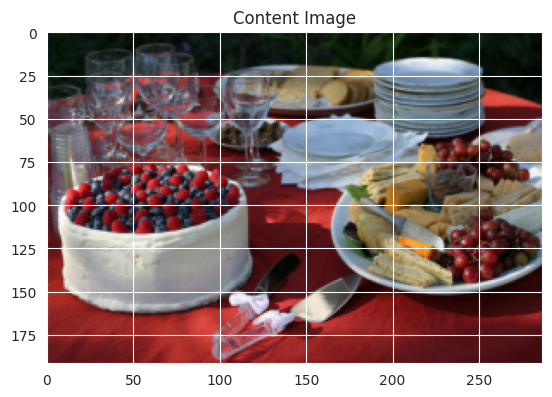

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


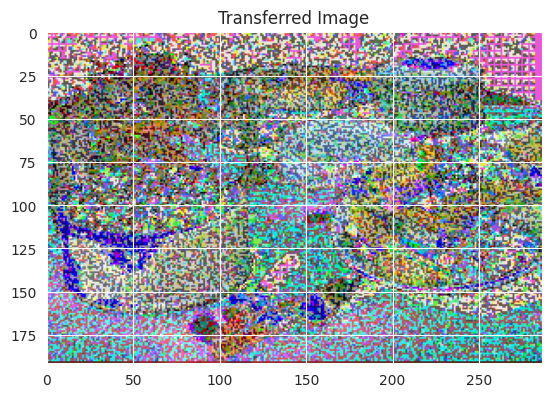

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

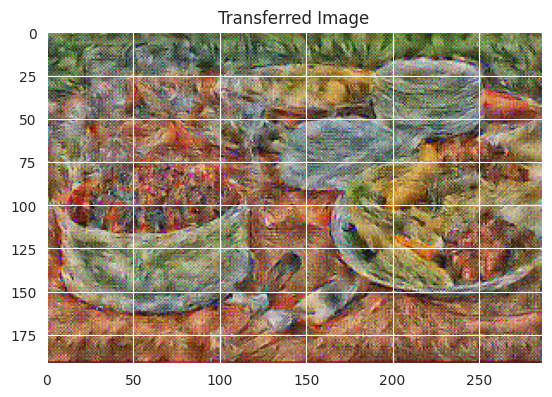

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

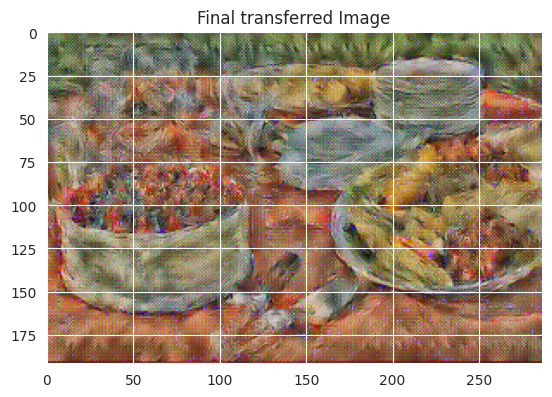

In [37]:
params5 = {
    'content_image':'contents/000000002157.jpg',
    'style_image':'styles/the_scream.jpg',
    'image_size':192,
    'style_size':224,
    'content_layer':6,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params5)

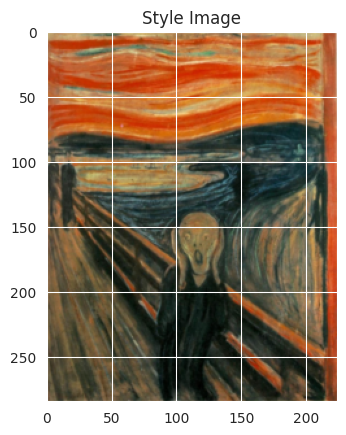

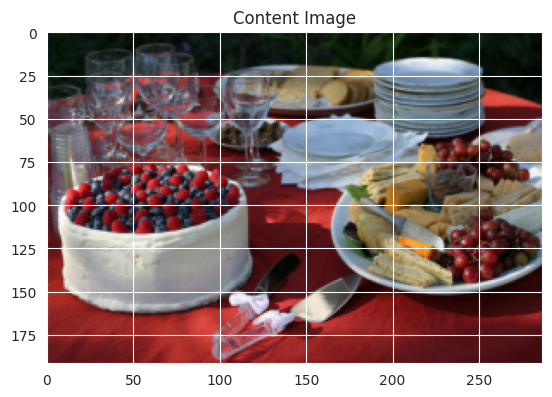

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


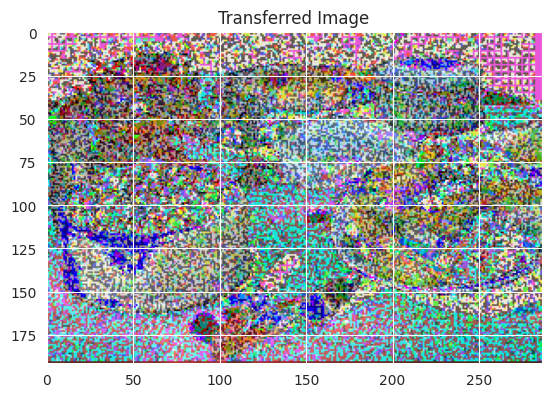

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

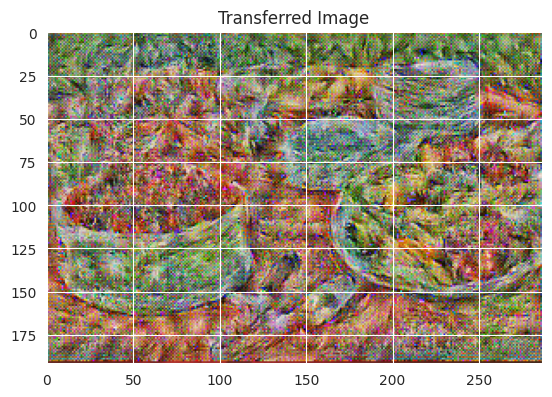

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

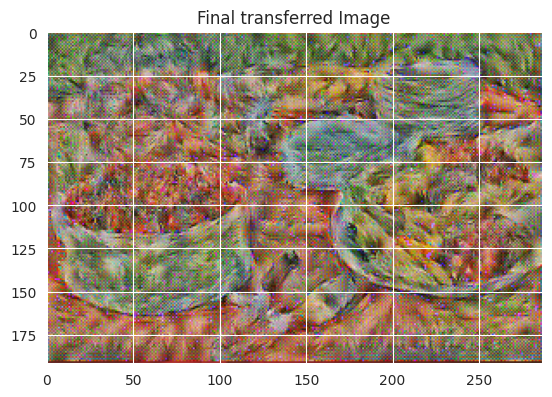

In [39]:
params6 = {
    'content_image':'contents/000000002157.jpg',
    'style_image':'styles/the_scream.jpg',
    'image_size':192,
    'style_size':224,
    'content_layer':8,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params6)

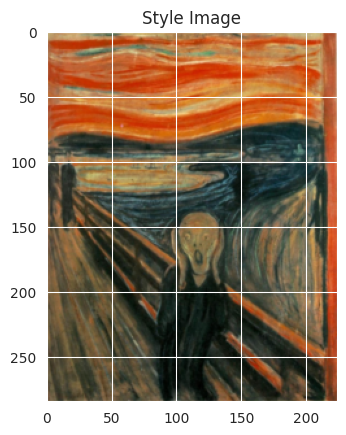

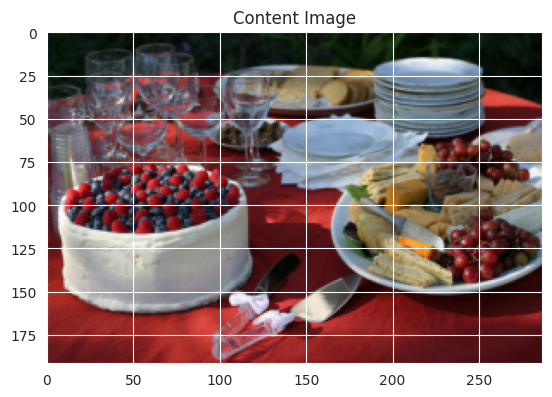

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


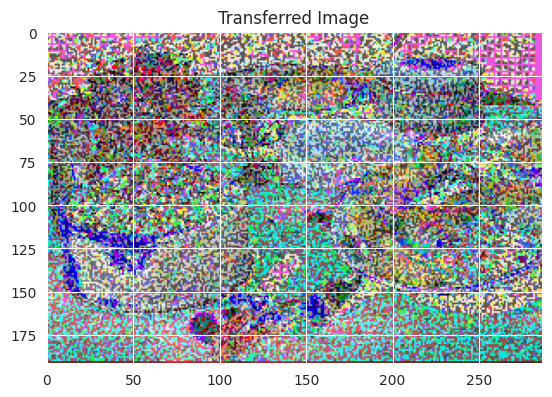

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

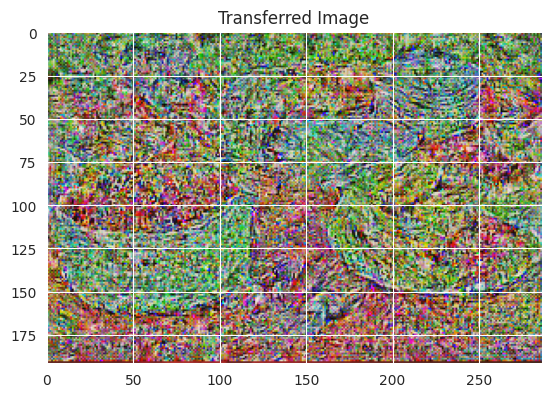

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

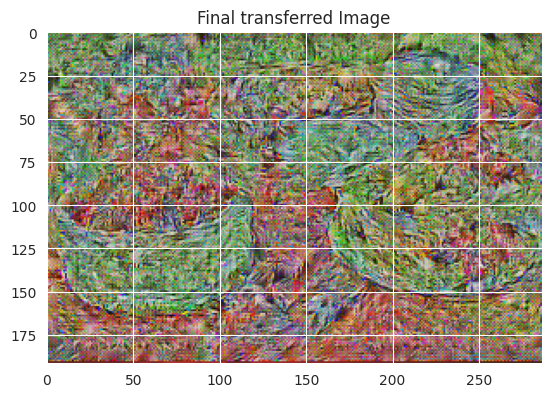

In [40]:
params7 = {
    'content_image':'contents/000000002157.jpg',
    'style_image':'styles/the_scream.jpg',
    'image_size':192,
    'style_size':224,
    'content_layer':10,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params7)

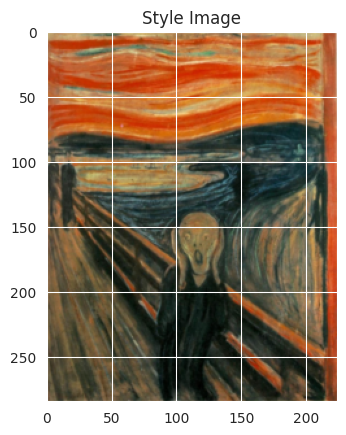

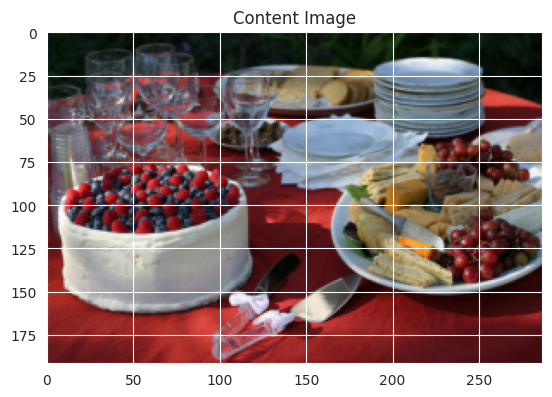

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


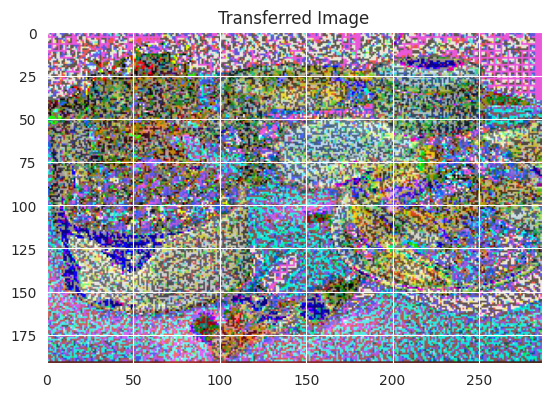

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

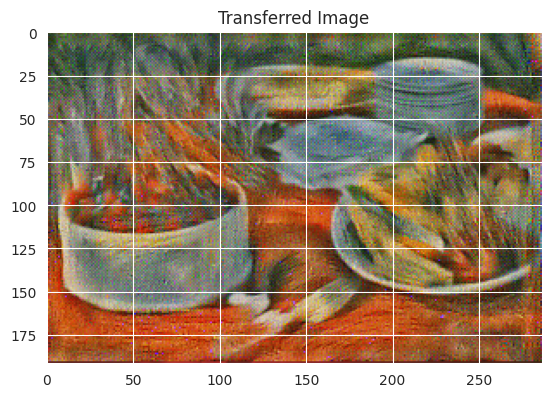

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

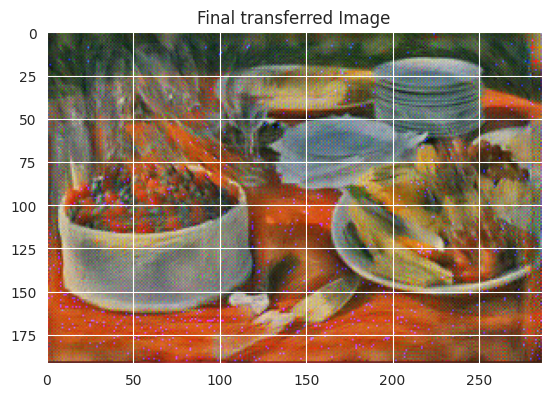

In [42]:
params8 = {
    'content_image':'contents/000000002157.jpg',
    'style_image':'styles/the_scream.jpg',
    'image_size':192,
    'style_size':224,
    'content_layer':1,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params8)

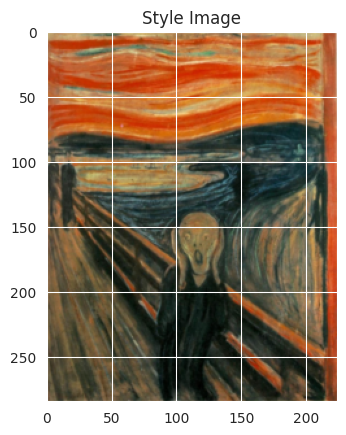

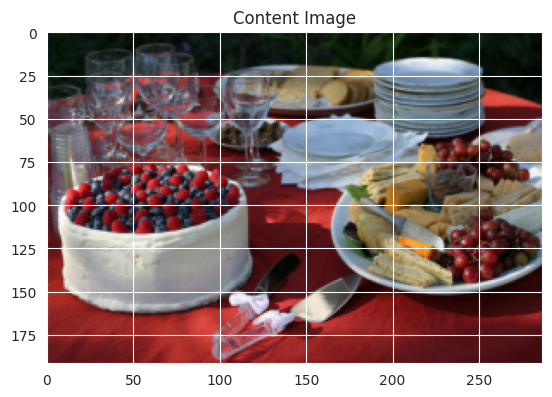

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


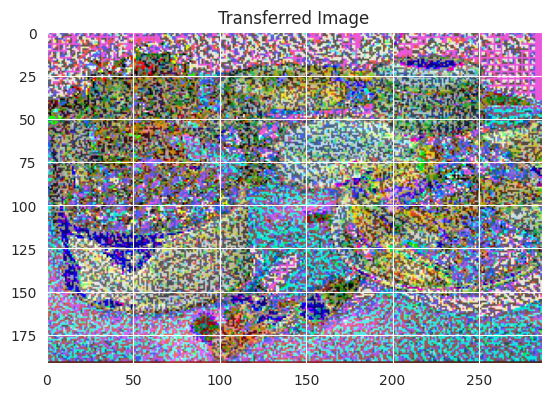

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

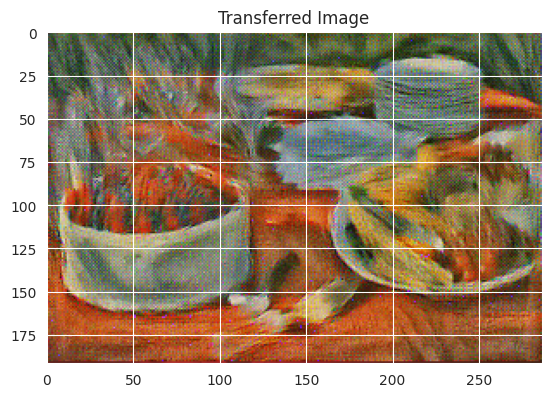

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

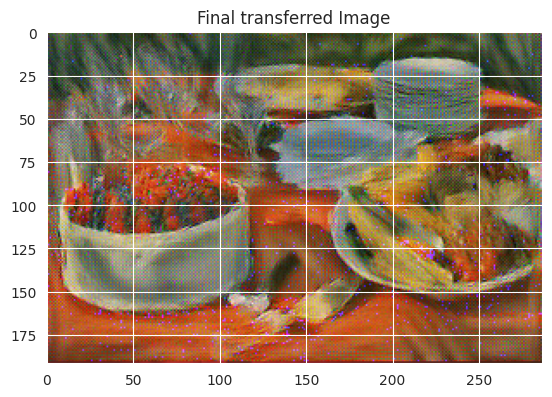

In [43]:
params9 = {
    'content_image':'contents/000000002157.jpg',
    'style_image':'styles/the_scream.jpg',
    'image_size':192,
    'style_size':224,
    'content_layer':3,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params9)

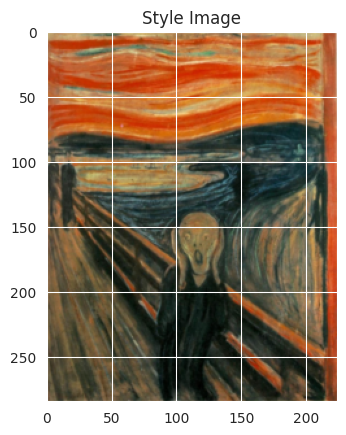

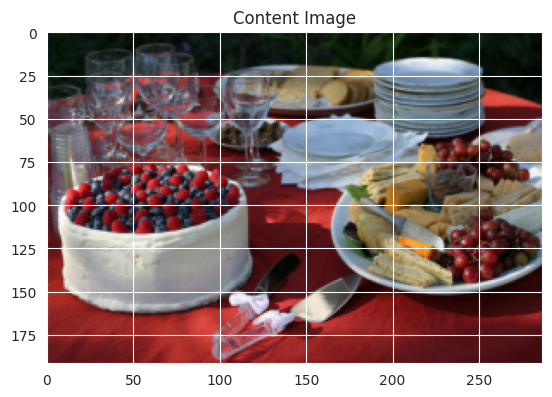

~~~~~~Style Transfer Loop No.0~~~~~~
Iteration 0


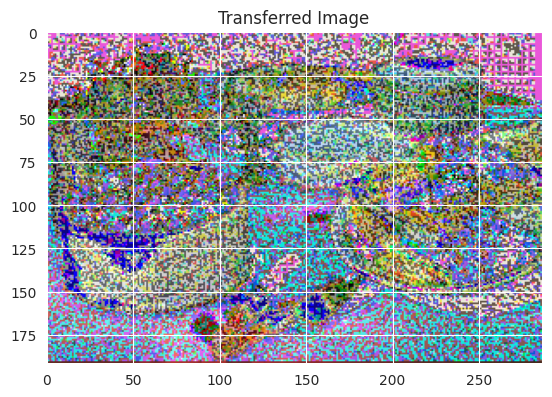

~~~~~~Style Transfer Loop No.1~~~~~~
~~~~~~Style Transfer Loop No.2~~~~~~
~~~~~~Style Transfer Loop No.3~~~~~~
~~~~~~Style Transfer Loop No.4~~~~~~
~~~~~~Style Transfer Loop No.5~~~~~~
~~~~~~Style Transfer Loop No.6~~~~~~
~~~~~~Style Transfer Loop No.7~~~~~~
~~~~~~Style Transfer Loop No.8~~~~~~
~~~~~~Style Transfer Loop No.9~~~~~~
~~~~~~Style Transfer Loop No.10~~~~~~
~~~~~~Style Transfer Loop No.11~~~~~~
~~~~~~Style Transfer Loop No.12~~~~~~
~~~~~~Style Transfer Loop No.13~~~~~~
~~~~~~Style Transfer Loop No.14~~~~~~
~~~~~~Style Transfer Loop No.15~~~~~~
~~~~~~Style Transfer Loop No.16~~~~~~
~~~~~~Style Transfer Loop No.17~~~~~~
~~~~~~Style Transfer Loop No.18~~~~~~
~~~~~~Style Transfer Loop No.19~~~~~~
~~~~~~Style Transfer Loop No.20~~~~~~
~~~~~~Style Transfer Loop No.21~~~~~~
~~~~~~Style Transfer Loop No.22~~~~~~
~~~~~~Style Transfer Loop No.23~~~~~~
~~~~~~Style Transfer Loop No.24~~~~~~
~~~~~~Style Transfer Loop No.25~~~~~~
~~~~~~Style Transfer Loop No.26~~~~~~
~~~~~~Style Transfer 

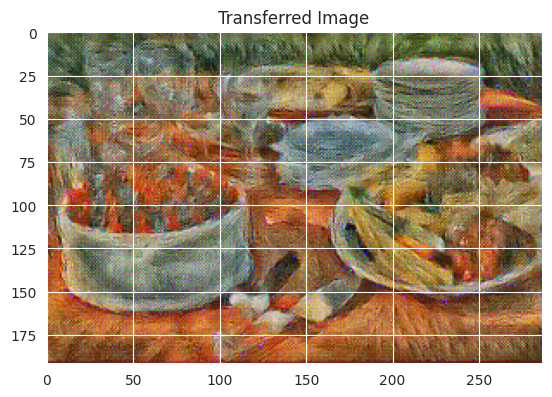

~~~~~~Style Transfer Loop No.101~~~~~~
~~~~~~Style Transfer Loop No.102~~~~~~
~~~~~~Style Transfer Loop No.103~~~~~~
~~~~~~Style Transfer Loop No.104~~~~~~
~~~~~~Style Transfer Loop No.105~~~~~~
~~~~~~Style Transfer Loop No.106~~~~~~
~~~~~~Style Transfer Loop No.107~~~~~~
~~~~~~Style Transfer Loop No.108~~~~~~
~~~~~~Style Transfer Loop No.109~~~~~~
~~~~~~Style Transfer Loop No.110~~~~~~
~~~~~~Style Transfer Loop No.111~~~~~~
~~~~~~Style Transfer Loop No.112~~~~~~
~~~~~~Style Transfer Loop No.113~~~~~~
~~~~~~Style Transfer Loop No.114~~~~~~
~~~~~~Style Transfer Loop No.115~~~~~~
~~~~~~Style Transfer Loop No.116~~~~~~
~~~~~~Style Transfer Loop No.117~~~~~~
~~~~~~Style Transfer Loop No.118~~~~~~
~~~~~~Style Transfer Loop No.119~~~~~~
~~~~~~Style Transfer Loop No.120~~~~~~
~~~~~~Style Transfer Loop No.121~~~~~~
~~~~~~Style Transfer Loop No.122~~~~~~
~~~~~~Style Transfer Loop No.123~~~~~~
~~~~~~Style Transfer Loop No.124~~~~~~
~~~~~~Style Transfer Loop No.125~~~~~~
~~~~~~Style Transfer Loop

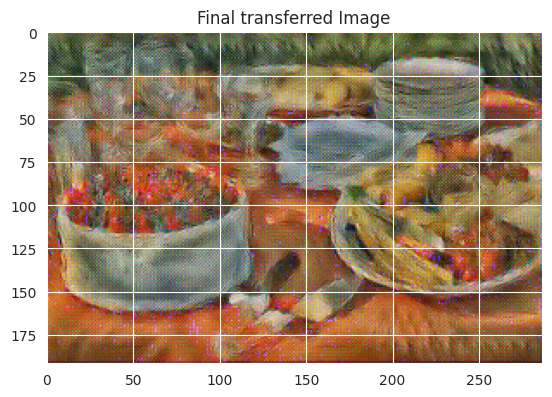

In [44]:
params10 = {
    'content_image':'contents/000000002157.jpg',
    'style_image':'styles/the_scream.jpg',
    'image_size':192,
    'style_size':224,
    'content_layer':5,
    'content_weight':3e-2,
    'style_layers':[1, 4, 6, 7],
    'style_weights':[200000, 800, 12, 1],
}

style_transfer(**params10)

### **TODO**: 
Finally, we will try varying the layer used to compute the content loss. Try
different layers l = 0, 1, 2, ..., 12 and report which one provides the best qualitative results.

***It seems that the final transferred image goes worse and worse when the number of content layers is larger than 5, when the number equals to 1 or 2, it seems the style matches quite well with the style image, while the content is not clear enough, and when the number of content layers equals to 3, 4, or 5, the content seems matched quite well with the content image, and the style also matches with the style image, but the style is not as close to the original style image as those with 1 or 2 content layers.***

# Convert Notebook to PDF

[Alternative if the cell below doesn't work.](https://docs.google.com/document/d/1QTutnoApRow8cOxNrKK6ISEkA72QGfwLFXbIcpvarAI/edit?usp=sharing)

In [33]:
# generate pdf
# jupyter nbconvert --to PDF ruiche_87169154_ps6.ipynb